In [ ]:
!pip install shap scikit-learn

In [ ]:
!pip install lime scikit-learn

In [ ]:
!pip install --upgrade scikit-learn -q --user

In [ ]:
!pip install --upgrade scikit-learn

In [ ]:
!pip install shap --upgrade

In [ ]:
!pip install lime --upgrade

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
#sns.set(style="darkgrid")
sns.set(
    style="darkgrid",
    context='talk',
    font_scale=0.8,
    rc={'figure.figsize': (6,4)}
)
pd.set_option('display.max_columns', None)

In [ ]:
#sns.set(
#    style='ticks',
#    context='talk',
#    font_scale=0.8,
#    rc={'figure.figsize': (6,4)}
#)
%config InlineBackend.figure_formats = set(('retina', 'svg'))

%matplotlib inline

import shap
shap.initjs()

#for reproducibility
import random
seed=42
random.seed(seed)
np.random.seed(seed)

import warnings
warnings.simplefilter('ignore')

In [ ]:
import lime
import lime.lime_tabular

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
df = pd.read_csv('/content/drive/MyDrive/meningitis_dataset.csv')

In [ ]:
df

,id,surname,firstname,middlename,gender,gender_male,gender_female,state,settlement,rural_settlement,urban_settlement,report_date,report_year,age,age_str,date_of_birth,child_group,adult_group,disease,cholera,diarrhoea,measles,viral_haemmorrhaphic_fever,meningitis,ebola,marburg_virus,yellow_fever,rubella_mars,malaria,serotype,NmA,NmC,NmW,health_status,alive,dead,report_outcome,unconfirmed,confirmed,null_serotype
0,1,Solade,Grace,Solape,Female,0,1,Rivers,Rural,1,0,2018-05-15,2018,32,32 years,1986-01-17,0,1,Cholera,1,0,0,0,0,0,0,0,0,0,null serotype,0,0,0,alive,1,0,confirmed,0,1,1
1,2,Eneche,Kure,Balogun,Male,1,0,Ebonyi,Rural,1,0,2017-02-28,2017,32,32 years,1985-09-01,0,1,Marburg Virus,0,0,0,0,0,0,1,0,0,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
2,3,Sanusi,Adaugo,Katerine,Female,0,1,Ogun,Urban,0,1,2012-03-02,2012,24,24 years,1988-05-01,0,1,Marburg Virus,0,0,0,0,0,0,1,0,0,0,Null,0,0,1,Dead,0,1,Not Confirmed,1,0,1
3,4,Sowore,Mooslemat,Ifedayo,Female,0,1,Ondo,Rural,1,0,2010-05-21,2010,63,63 years,1947-05-24,0,1,Measles,0,0,1,0,0,0,0,0,0,0,Null,0,0,1,Alive,1,0,Not Confirmed,1,0,1
4,5,Abdusalam,Yusuf,Okafor,Male,1,0,Oyo,Urban,0,1,2017-08-28,2017,9,9 years,2008-01-07,1,0,Rubella Mars,0,0,0,0,0,0,0,0,1,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
284479,288418,Mukthar,Alimat,Ajibewa,Female,0,1,Cross River,Rural,1,0,2012-08-24,2012,67,67 years,1945-07-10,0,1,Ebola,0,0,0,0,0,1,0,0,0,0,Null,0,0,1,Dead,0,1,Confirmed,1,0,1
284480,288419,Akenzua,Deborah,Rofeeqat,Female,0,1,Kwara,Urban,0,1,2009-01-19,2009,64,64 years,1945-01-27,0,1,Ebola,0,0,0,0,0,1,0,0,0,0,Null,0,0,1,Dead,0,1,Confirmed,1,0,1
284481,288420,Isa,Deborah,Tofunmi,Female,0,1,Katsina,Rural,1,0,2010-06-10,2010,33,33 years,1977-10-03,0,1,Malaria,0,0,0,0,0,0,0,0,0,1,Null,0,0,1,Alive,1,0,Confirmed,0,1,1
284482,288421,Uba,Ismail,Akpabio,Male,1,0,Jigawa,Rural,1,0,2016-01-11,2016,18,18 years,1998-05-07,0,1,Malaria,0,0,0,0,0,0,0,0,0,1,Null,0,0,1,Dead,0,1,Not Confirmed,1,0,1


# **EXPLORATORY DATA ANALYSIS**

In [ ]:
df.isna().sum().sum()

0

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284484 entries, 0 to 284483
Data columns (total 40 columns):
 #   Column                      Non-Null Count   Dtype 
---  ------                      --------------   ----- 
 0   id                          284484 non-null  int64 
 1   surname                     284484 non-null  object
 2   firstname                   284484 non-null  object
 3   middlename                  284484 non-null  object
 4   gender                      284484 non-null  object
 5   gender_male                 284484 non-null  int64 
 6   gender_female               284484 non-null  int64 
 7   state                       284484 non-null  object
 8   settlement                  284484 non-null  object
 9   rural_settlement            284484 non-null  int64 
 10  urban_settlement            284484 non-null  int64 
 11  report_date                 284484 non-null  object
 12  report_year                 284484 non-null  int64 
 13  age                         2

In [ ]:
df_num = df.select_dtypes(include=[np.number])
df_cat = df.select_dtypes(include=['object'])

In [ ]:
df_cat

,surname,firstname,middlename,gender,state,settlement,report_date,age_str,date_of_birth,disease,serotype,health_status,report_outcome
0,Solade,Grace,Solape,Female,Rivers,Rural,2018-05-15,32 years,1986-01-17,Cholera,null serotype,alive,confirmed
1,Eneche,Kure,Balogun,Male,Ebonyi,Rural,2017-02-28,32 years,1985-09-01,Marburg Virus,Null,Alive,Confirmed
2,Sanusi,Adaugo,Katerine,Female,Ogun,Urban,2012-03-02,24 years,1988-05-01,Marburg Virus,Null,Dead,Not Confirmed
3,Sowore,Mooslemat,Ifedayo,Female,Ondo,Rural,2010-05-21,63 years,1947-05-24,Measles,Null,Alive,Not Confirmed
4,Abdusalam,Yusuf,Okafor,Male,Oyo,Urban,2017-08-28,9 years,2008-01-07,Rubella Mars,Null,Alive,Confirmed
...,...,...,...,...,...,...,...,...,...,...,...,...,...
284479,Mukthar,Alimat,Ajibewa,Female,Cross River,Rural,2012-08-24,67 years,1945-07-10,Ebola,Null,Dead,Confirmed
284480,Akenzua,Deborah,Rofeeqat,Female,Kwara,Urban,2009-01-19,64 years,1945-01-27,Ebola,Null,Dead,Confirmed
284481,Isa,Deborah,Tofunmi,Female,Katsina,Rural,2010-06-10,33 years,1977-10-03,Malaria,Null,Alive,Confirmed
284482,Uba,Ismail,Akpabio,Male,Jigawa,Rural,2016-01-11,18 years,1998-05-07,Malaria,Null,Dead,Not Confirmed


In [ ]:
df_cdat = df_cat.drop(['surname', 'firstname', 'middlename', 'date_of_birth'], axis=1)

In [ ]:
print(df_cdat.columns)
df_cdat.rename(columns={'report_date': 'date', 'health_status': 'status', 'report_outcome': 'outcome'}, inplace=True)
print(df_cdat.columns)

Index(['gender', 'state', 'settlement', 'report_date', 'age_str', 'disease',
       'serotype', 'health_status', 'report_outcome'],
      dtype='object')
Index(['gender', 'state', 'settlement', 'date', 'age_str', 'disease',
       'serotype', 'status', 'outcome'],
      dtype='object')


In [ ]:
df_cdat['gender'].unique()
#print(df_cdat['gender'].nunique())

array(['Female', 'Male'], dtype=object)

In [ ]:
df_cdat['settlement'].unique()

array(['Rural', 'Urban'], dtype=object)

In [ ]:
df_cdat['status'].unique()

array(['alive', 'Alive', 'Dead'], dtype=object)

In [ ]:
df_cdat['outcome'].unique()

array(['confirmed', 'Confirmed', 'Not Confirmed'], dtype=object)

In [ ]:
df_cdat['serotype'].unique()

array(['null serotype', 'Null', 'Neisseria meningitidis group A (NmA)',
       'Neisseria meningitidis group W (NmW)',
       'Neisseria meningitidis group C (NmC)'], dtype=object)

In [ ]:
df_cdat['disease'].unique()

array(['Cholera', 'Marburg Virus', 'Measles', 'Rubella Mars', 'Ebola',
       'Yellow Fever', 'Diarrhoea', 'Meningitis', 'Malaria',
       'Viral Haemmorrhaphic Fever'], dtype=object)

In [ ]:
df_cdat.replace({'Female': 0, 'Male': 1, 'Rural': 0, 'Urban': 1, 'Dead': 0, 'alive': 1, 'Alive': 1, 'Not Confirmed': 0, \
                 'confirmed': 1, 'Confirmed': 1, 'null serotype': 'Null', 'Neisseria meningitidis group A (NmA)': 'NmA', \
                 'Neisseria meningitidis group W (NmW)': 'NmW', 'Neisseria meningitidis group C (NmC)': 'NmC',
                }, inplace=True)

In [ ]:
df_cdat['state'].unique()

array(['Rivers', 'Ebonyi', 'Ogun', 'Ondo', 'Oyo', 'Kaduna', 'Taraba',
       'Katsina', 'Osun', 'Niger', 'Cross River', 'Adamawa', 'Nasarawa',
       'Imo', 'Abia', 'Yobe', 'Delta', 'Jigawa', 'Borno', 'Kwara',
       'Bayelsa', 'Federal Capital Territory', 'Kogi', 'Gombe', 'Sokoto',
       'Anambra', 'Kebbi', 'Lagos', 'Plateau', 'Zamfara', 'Edo', 'Ekiti',
       'Enugu', 'Bauchi', 'Kano', 'Benue', 'Akwa Ibom'], dtype=object)

In [ ]:
sbyz = {'Abia': 'SE', 'Adamawa': 'NE', 'Akwa Ibom': 'SS', 'Anambra': 'SE', 'Bauchi': 'NE', 'Bayelsa': 'SS', 'Benue': 'NC', \
        'Borno': 'NE', 'Cross River': 'SS', 'Delta': 'SS', 'Ebonyi': 'SE', 'Edo': 'SS', 'Ekiti': 'SW', 'Enugu': 'SE', \
        'Federal Capital Territory': 'NC', 'Gombe': 'NE', 'Imo': 'SE', 'Jigawa': 'NW', 'Kaduna': 'NW', 'Kano': 'NW', \
        'Katsina': 'NW', 'Kebbi': 'NW', 'Kogi': 'NC', 'Kwara': 'NC', 'Lagos': 'SW', 'Nasarawa': 'NC', 'Niger': 'NC', \
        'Ogun': 'SW', 'Ondo': 'SW', 'Osun': 'SW', 'Oyo': 'SW', 'Plateau': 'NC', 'Rivers': 'SS', 'Sokoto': 'NW', \
        'Taraba': 'NE', 'Yobe': 'NE', 'Zamfara': 'NW'}
df_cdat['zone'] = df_cdat['state'].replace(sbyz)

In [ ]:
df_cdat

,gender,state,settlement,date,age_str,disease,serotype,status,outcome,zone
0,0,Rivers,0,2018-05-15,32 years,Cholera,Null,1,1,SS
1,1,Ebonyi,0,2017-02-28,32 years,Marburg Virus,Null,1,1,SE
2,0,Ogun,1,2012-03-02,24 years,Marburg Virus,Null,0,0,SW
3,0,Ondo,0,2010-05-21,63 years,Measles,Null,1,0,SW
4,1,Oyo,1,2017-08-28,9 years,Rubella Mars,Null,1,1,SW
...,...,...,...,...,...,...,...,...,...,...
284479,0,Cross River,0,2012-08-24,67 years,Ebola,Null,0,1,SS
284480,0,Kwara,1,2009-01-19,64 years,Ebola,Null,0,1,NC
284481,0,Katsina,0,2010-06-10,33 years,Malaria,Null,1,1,NW
284482,1,Jigawa,0,2016-01-11,18 years,Malaria,Null,0,0,NW


In [ ]:
df_cdat['date'].nunique()

3653

In [ ]:
df_cdat['date'].value_counts().to_string()

'0000-00-00    1372\n2010-12-09     118\n2011-09-22     109\n2015-05-25     107\n2012-09-19     106\n2010-12-18     106\n2009-07-18     106\n2018-10-04     106\n2011-09-29     105\n2009-09-14     104\n2010-08-06     104\n2012-10-14     104\n2017-01-29     103\n2018-05-13     103\n2010-07-22     103\n2012-05-10     103\n2015-11-09     102\n2018-02-23     102\n2016-03-08     102\n2015-01-14     102\n2011-05-21     102\n2009-02-25     102\n2017-10-21     102\n2015-09-13     102\n2013-05-04     101\n2013-07-07     101\n2013-10-10     101\n2018-06-28     100\n2010-12-14     100\n2012-03-01     100\n2016-05-21     100\n2018-01-10     100\n2013-07-30     100\n2018-08-11     100\n2016-06-28      99\n2009-09-13      99\n2014-10-29      99\n2016-06-16      99\n2013-12-10      99\n2014-06-02      99\n2016-06-25      99\n2009-05-17      99\n2016-02-27      98\n2012-07-24      98\n2017-10-12      98\n2012-06-22      98\n2010-05-12      98\n2012-10-06      98\n2010-04-20      98\n2017-06-30      98\

In [ ]:
df_cdat['date'] = pd.to_datetime(df_cdat['date'], errors='coerce')

df_cdat['ryear'] = df_cdat['date'].apply(lambda time: time.year)
df_cdat['rmonth'] = df_cdat['date'].apply(lambda time: time.month)
df_cdat['rday'] = df_cdat['date'].apply(lambda time: time.day)

In [ ]:
df_cdat['ryear'] = df_cdat['ryear'].astype(float)
df_cdat['rmonth'] = df_cdat['rmonth'].astype(float)
df_cdat['rday'] = df_cdat['rday'].astype(float)

In [ ]:
for i, value in enumerate(df_cdat['age_str']):
    w = value.split(" ")
    age_value = int(w[0])

    if 'days' in value and age_value <= 18:
        df_cdat.at[i, 'age_group'] = 0
    elif 'months' in value or ('years' in value and age_value < 18):
        df_cdat.at[i, 'age_group'] = 0
    elif 'days' in value and age_value > 18:
        df_cdat.at[i, 'age_group'] = 0
    elif 'years' in value and age_value >= 18:
        df_cdat.at[i, 'age_group'] = 1

In [ ]:
nan_check = df_cdat.isna().any()

In [ ]:
# Print columns with NaN values and their counts
for column, has_nan in nan_check.items():
    if has_nan:
        nan_count = df_cdat[column].isna().sum()
        print(f"Column '{column}' has {nan_count} NaN value(s).")

Column 'date' has 1372 NaN value(s).
Column 'ryear' has 1372 NaN value(s).
Column 'rmonth' has 1372 NaN value(s).
Column 'rday' has 1372 NaN value(s).


In [ ]:
# Filter rows where 'rday' has NaN values
nan_rows = df_cdat[df_cdat['rday'].isna()]

# Display the rows
print(nan_rows)

        gender     state  settlement date   age_str        disease serotype  \
23           1      Ogun           0  NaT  59 years      Diarrhoea     Null   
209250       0     Kebbi           1  NaT  4 months        Cholera     Null   
209256       1    Rivers           0  NaT  69 years   Rubella Mars     Null   
209307       1   Zamfara           1  NaT  33 years  Marburg Virus     Null   
209388       0     Lagos           1  NaT  45 years          Ebola     Null   
...        ...       ...         ...  ...       ...            ...      ...   
284122       0  Nasarawa           1  NaT  40 years     Meningitis      NmC   
284138       1    Taraba           0  NaT  2 months        Cholera     Null   
284150       0     Kwara           1  NaT  14 years          Ebola     Null   
284330       0   Katsina           1  NaT  66 years        Cholera     Null   
284459       0     Kwara           0  NaT  8 months      Diarrhoea     Null   

        status  outcome zone  ryear  rmonth  rday  

In [ ]:
# Filter rows where 'rmonth' has NaN values
nan_rows = df_cdat[df_cdat['rmonth'].isna()]

# Display the rows
print(nan_rows)

        gender     state  settlement date   age_str        disease serotype  \
23           1      Ogun           0  NaT  59 years      Diarrhoea     Null   
209250       0     Kebbi           1  NaT  4 months        Cholera     Null   
209256       1    Rivers           0  NaT  69 years   Rubella Mars     Null   
209307       1   Zamfara           1  NaT  33 years  Marburg Virus     Null   
209388       0     Lagos           1  NaT  45 years          Ebola     Null   
...        ...       ...         ...  ...       ...            ...      ...   
284122       0  Nasarawa           1  NaT  40 years     Meningitis      NmC   
284138       1    Taraba           0  NaT  2 months        Cholera     Null   
284150       0     Kwara           1  NaT  14 years          Ebola     Null   
284330       0   Katsina           1  NaT  66 years        Cholera     Null   
284459       0     Kwara           0  NaT  8 months      Diarrhoea     Null   

        status  outcome zone  ryear  rmonth  rday  

In [ ]:
# Filter rows where 'ryear' has NaN values
nan_rows = df_cdat[df_cdat['ryear'].isna()]

# Display the rows
print(nan_rows)

        gender     state  settlement date   age_str        disease serotype  \
23           1      Ogun           0  NaT  59 years      Diarrhoea     Null   
209250       0     Kebbi           1  NaT  4 months        Cholera     Null   
209256       1    Rivers           0  NaT  69 years   Rubella Mars     Null   
209307       1   Zamfara           1  NaT  33 years  Marburg Virus     Null   
209388       0     Lagos           1  NaT  45 years          Ebola     Null   
...        ...       ...         ...  ...       ...            ...      ...   
284122       0  Nasarawa           1  NaT  40 years     Meningitis      NmC   
284138       1    Taraba           0  NaT  2 months        Cholera     Null   
284150       0     Kwara           1  NaT  14 years          Ebola     Null   
284330       0   Katsina           1  NaT  66 years        Cholera     Null   
284459       0     Kwara           0  NaT  8 months      Diarrhoea     Null   

        status  outcome zone  ryear  rmonth  rday  

In [ ]:
df_cdat

,gender,state,settlement,date,age_str,disease,serotype,status,outcome,zone,ryear,rmonth,rday,age_group
0,0,Rivers,0,2018-05-15,32 years,Cholera,Null,1,1,SS,2018.0,5.0,15.0,1.0
1,1,Ebonyi,0,2017-02-28,32 years,Marburg Virus,Null,1,1,SE,2017.0,2.0,28.0,1.0
2,0,Ogun,1,2012-03-02,24 years,Marburg Virus,Null,0,0,SW,2012.0,3.0,2.0,1.0
3,0,Ondo,0,2010-05-21,63 years,Measles,Null,1,0,SW,2010.0,5.0,21.0,1.0
4,1,Oyo,1,2017-08-28,9 years,Rubella Mars,Null,1,1,SW,2017.0,8.0,28.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
284479,0,Cross River,0,2012-08-24,67 years,Ebola,Null,0,1,SS,2012.0,8.0,24.0,1.0
284480,0,Kwara,1,2009-01-19,64 years,Ebola,Null,0,1,NC,2009.0,1.0,19.0,1.0
284481,0,Katsina,0,2010-06-10,33 years,Malaria,Null,1,1,NW,2010.0,6.0,10.0,1.0
284482,1,Jigawa,0,2016-01-11,18 years,Malaria,Null,0,0,NW,2016.0,1.0,11.0,1.0


In [ ]:
df_cdat['rday'].fillna(df_cdat['rday'].mean(), inplace=True)
df_cdat['rday'] = df_cdat['rday'].round(1)

In [ ]:
df_cdat['rmonth'].fillna(df_cdat['rmonth'].mean(), inplace=True)
df_cdat['rmonth'] = df_cdat['rmonth'].round(1)

In [ ]:
df_cdat['ryear'].fillna(df_cdat['ryear'].mean(), inplace=True)
df_cdat['ryear'] = df_cdat['ryear'].round(1)

In [ ]:
# Print columns with NaN values and their counts
for column, has_nan in nan_check.items():
    if has_nan:
        nan_count = df_cdat[column].isna().sum()
        print(f"Column '{column}' has {nan_count} NaN value(s).")

Column 'date' has 1372 NaN value(s).
Column 'ryear' has 0 NaN value(s).
Column 'rmonth' has 0 NaN value(s).
Column 'rday' has 0 NaN value(s).


In [ ]:
df_cdat.shape

(284484, 14)

In [ ]:
from sklearn.preprocessing import OneHotEncoder

In [ ]:
zones = pd.DataFrame(df_cdat['zone'])
zones['zone'] = zones['zone'].astype('category')
zones['zone_code'] = zones['zone'].cat.codes

z_dict = dict(enumerate(zones['zone'].cat.categories))

enc = OneHotEncoder()
enc_zone = pd.DataFrame(enc.fit_transform(zones[['zone']]).toarray())

enc_zone.rename(columns=z_dict, inplace=True)

df_cdat= df_cdat.join(enc_zone)
df_cdat

,gender,state,settlement,date,age_str,disease,serotype,status,outcome,zone,ryear,rmonth,rday,age_group,NC,NE,NW,SE,SS,SW
0,0,Rivers,0,2018-05-15,32 years,Cholera,Null,1,1,SS,2018.0,5.0,15.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
1,1,Ebonyi,0,2017-02-28,32 years,Marburg Virus,Null,1,1,SE,2017.0,2.0,28.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0,Ogun,1,2012-03-02,24 years,Marburg Virus,Null,0,0,SW,2012.0,3.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
3,0,Ondo,0,2010-05-21,63 years,Measles,Null,1,0,SW,2010.0,5.0,21.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
4,1,Oyo,1,2017-08-28,9 years,Rubella Mars,Null,1,1,SW,2017.0,8.0,28.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
284479,0,Cross River,0,2012-08-24,67 years,Ebola,Null,0,1,SS,2012.0,8.0,24.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
284480,0,Kwara,1,2009-01-19,64 years,Ebola,Null,0,1,NC,2009.0,1.0,19.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0
284481,0,Katsina,0,2010-06-10,33 years,Malaria,Null,1,1,NW,2010.0,6.0,10.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0
284482,1,Jigawa,0,2016-01-11,18 years,Malaria,Null,0,0,NW,2016.0,1.0,11.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0


In [ ]:
serotypes = pd.DataFrame(df_cdat['serotype'])
serotypes['serotype'] = serotypes['serotype'].astype('category')
serotypes['serotype_code'] = serotypes['serotype'].cat.codes

s_dict = dict(enumerate(serotypes['serotype'].cat.categories))

enc = OneHotEncoder()
enc_serotype = pd.DataFrame(enc.fit_transform(serotypes[['serotype']]).toarray())

enc_serotype.rename(columns=s_dict, inplace=True)

df_cdat= df_cdat.join(enc_serotype)
df_cdat

,gender,state,settlement,date,age_str,disease,serotype,status,outcome,zone,ryear,rmonth,rday,age_group,NC,NE,NW,SE,SS,SW,NmA,NmC,NmW,Null
0,0,Rivers,0,2018-05-15,32 years,Cholera,Null,1,1,SS,2018.0,5.0,15.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
1,1,Ebonyi,0,2017-02-28,32 years,Marburg Virus,Null,1,1,SE,2017.0,2.0,28.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0,Ogun,1,2012-03-02,24 years,Marburg Virus,Null,0,0,SW,2012.0,3.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
3,0,Ondo,0,2010-05-21,63 years,Measles,Null,1,0,SW,2010.0,5.0,21.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
4,1,Oyo,1,2017-08-28,9 years,Rubella Mars,Null,1,1,SW,2017.0,8.0,28.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
284479,0,Cross River,0,2012-08-24,67 years,Ebola,Null,0,1,SS,2012.0,8.0,24.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
284480,0,Kwara,1,2009-01-19,64 years,Ebola,Null,0,1,NC,2009.0,1.0,19.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
284481,0,Katsina,0,2010-06-10,33 years,Malaria,Null,1,1,NW,2010.0,6.0,10.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
284482,1,Jigawa,0,2016-01-11,18 years,Malaria,Null,0,0,NW,2016.0,1.0,11.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [ ]:
diseases = pd.DataFrame(df_cdat['disease'])
diseases['disease'] = diseases['disease'].astype('category')
diseases['disease_code'] = diseases['disease'].cat.codes

d_dict = dict(enumerate(diseases['disease'].cat.categories))

enc = OneHotEncoder()
enc_disease = pd.DataFrame(enc.fit_transform(diseases[['disease']]).toarray())

enc_disease.rename(columns=d_dict, inplace=True)

df_cdat= df_cdat.join(enc_disease)
df_cdat

,gender,state,settlement,date,age_str,disease,serotype,status,outcome,zone,ryear,rmonth,rday,age_group,NC,NE,NW,SE,SS,SW,NmA,NmC,NmW,Null,Cholera,Diarrhoea,Ebola,Malaria,Marburg Virus,Measles,Meningitis,Rubella Mars,Viral Haemmorrhaphic Fever,Yellow Fever
0,0,Rivers,0,2018-05-15,32 years,Cholera,Null,1,1,SS,2018.0,5.0,15.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,Ebonyi,0,2017-02-28,32 years,Marburg Virus,Null,1,1,SE,2017.0,2.0,28.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
2,0,Ogun,1,2012-03-02,24 years,Marburg Virus,Null,0,0,SW,2012.0,3.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
3,0,Ondo,0,2010-05-21,63 years,Measles,Null,1,0,SW,2010.0,5.0,21.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
4,1,Oyo,1,2017-08-28,9 years,Rubella Mars,Null,1,1,SW,2017.0,8.0,28.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
284479,0,Cross River,0,2012-08-24,67 years,Ebola,Null,0,1,SS,2012.0,8.0,24.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
284480,0,Kwara,1,2009-01-19,64 years,Ebola,Null,0,1,NC,2009.0,1.0,19.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
284481,0,Katsina,0,2010-06-10,33 years,Malaria,Null,1,1,NW,2010.0,6.0,10.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
284482,1,Jigawa,0,2016-01-11,18 years,Malaria,Null,0,0,NW,2016.0,1.0,11.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
df_c2n = df_cdat.drop(['state', 'date', 'age_str', 'disease', 'serotype', 'zone'], axis=1)
df_c2n

,gender,settlement,status,outcome,ryear,rmonth,rday,age_group,NC,NE,NW,SE,SS,SW,NmA,NmC,NmW,Null,Cholera,Diarrhoea,Ebola,Malaria,Marburg Virus,Measles,Meningitis,Rubella Mars,Viral Haemmorrhaphic Fever,Yellow Fever
0,0,0,1,1,2018.0,5.0,15.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,0,1,1,2017.0,2.0,28.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
2,0,1,0,0,2012.0,3.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
3,0,0,1,0,2010.0,5.0,21.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
4,1,1,1,1,2017.0,8.0,28.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
284479,0,0,0,1,2012.0,8.0,24.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
284480,0,1,0,1,2009.0,1.0,19.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
284481,0,0,1,1,2010.0,6.0,10.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
284482,1,0,0,0,2016.0,1.0,11.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
print(df_c2n.isna().sum())

gender                        0
settlement                    0
status                        0
outcome                       0
ryear                         0
rmonth                        0
rday                          0
age_group                     0
NC                            0
NE                            0
NW                            0
SE                            0
SS                            0
SW                            0
NmA                           0
NmC                           0
NmW                           0
Null                          0
Cholera                       0
Diarrhoea                     0
Ebola                         0
Malaria                       0
Marburg Virus                 0
Measles                       0
Meningitis                    0
Rubella Mars                  0
Viral Haemmorrhaphic Fever    0
Yellow Fever                  0
dtype: int64


In [ ]:
#used to clean the data and handle missing or infinite values
df_c2n = df_c2n[np.isfinite(df_c2n).all(1)]

In [ ]:
df_c2n.outcome.value_counts()

0    142746
1    141738
Name: outcome, dtype: int64

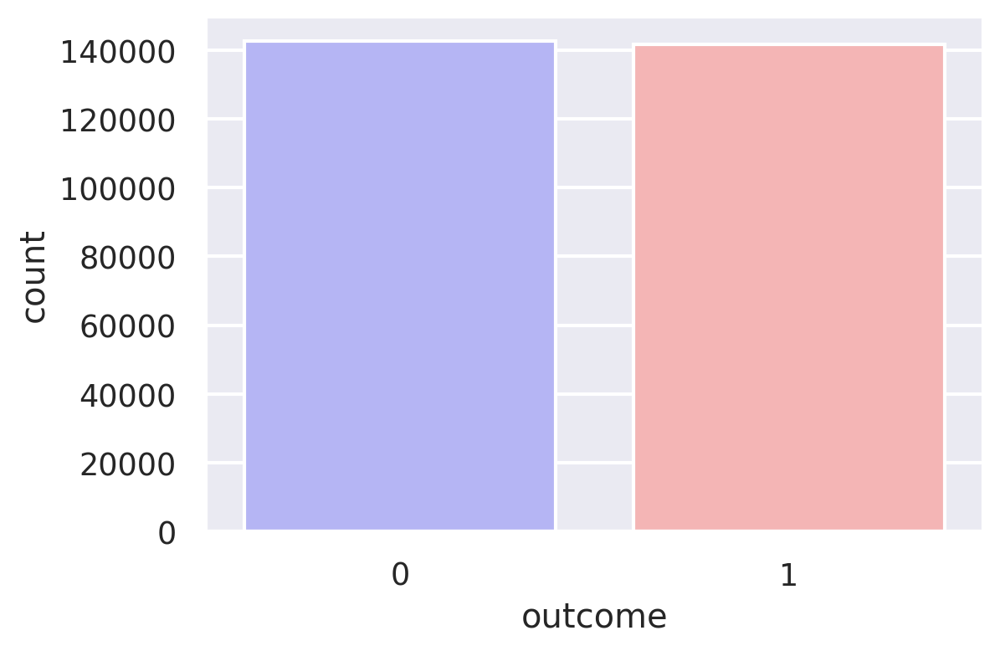

In [ ]:
sns.countplot(x="outcome",data=df_c2n, palette="bwr")
plt.show()

In [ ]:
countNoDisease = len(df_c2n[df_c2n.outcome == 0])
countHaveDisease = len(df_c2n[df_c2n.outcome == 1])
print("Percentage of Patients with no Disease: {:.2f}%".format((countNoDisease/(len(df_c2n.outcome))*100)))
print("Percentage of Patients with Disease: {:.2f}%".format((countHaveDisease/(len(df_c2n.outcome))*100)))

Percentage of Patients with no Disease: 50.18%
Percentage of Patients with Disease: 49.82%


In [ ]:
df_c2n.groupby('outcome').mean()

,gender,settlement,status,ryear,rmonth,rday,age_group,NC,NE,NW,SE,SS,SW,NmA,NmC,NmW,Null,Cholera,Diarrhoea,Ebola,Malaria,Marburg Virus,Measles,Meningitis,Rubella Mars,Viral Haemmorrhaphic Fever,Yellow Fever
outcome,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.484518,0.499222,0.499110,2013.500252,6.518957,15.741887,0.707999,0.189063,0.161441,0.190170,0.134792,0.162113,0.162421,0.024778,0.024883,0.050271,0.900067,0.100970,0.099968,0.098132,0.099716,0.100437,0.099477,0.099933,0.101026,0.100535,0.099807
1,0.480104,0.498518,0.500564,2013.506413,6.520496,15.757447,0.705640,0.190168,0.161206,0.189222,0.136999,0.160275,0.162130,0.024701,0.025244,0.049514,0.900542,0.100016,0.100749,0.099980,0.100897,0.099430,0.100686,0.099458,0.099606,0.099127,0.100051


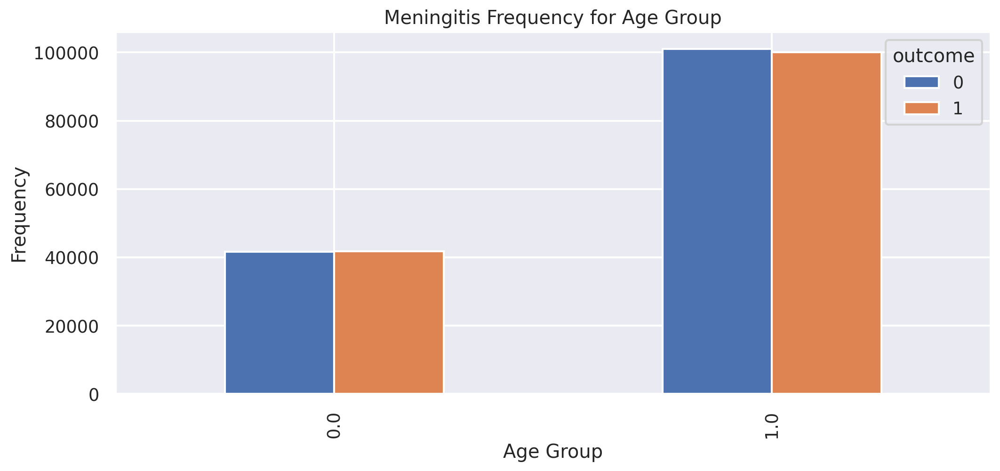

In [ ]:
pd.crosstab(df_c2n.age_group, df_c2n.outcome).plot(kind="bar", figsize=(12, 5))
plt.title('Meningitis Frequency for Age Group')
plt.xlabel('Age Group')
plt.ylabel('Frequency')
plt.savefig('meningitisByAges.png')
plt.show()

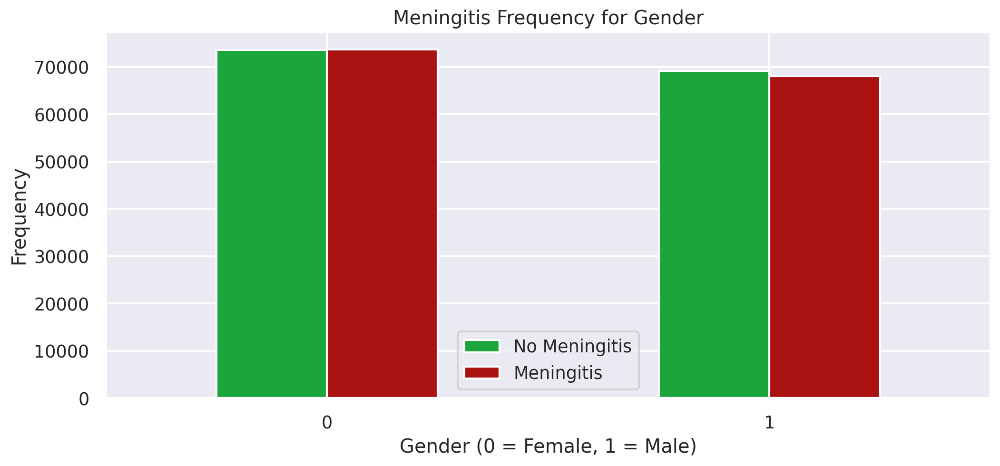

In [ ]:
pd.crosstab(df_c2n.gender, df_c2n.outcome).plot(kind="bar", figsize=(12, 5), color=['#1CA53B', '#AA1111'])
plt.title('Meningitis Frequency for Gender')
plt.xlabel('Gender (0 = Female, 1 = Male)')
plt.xticks(rotation=0)
plt.legend(["No Meningitis", "Meningitis"])
plt.ylabel('Frequency')
# plt.savefig('meningitisByAges.png')
plt.show()

In [ ]:
countFemale = len(df_c2n[df_c2n.gender == 0])
countMale = len(df_c2n[df_c2n.gender == 1])
print("Percentage of Female Patients: {:.2f}%".format((countFemale / (len(df_c2n.gender))*100)))
print("Percentage of Male Patients: {:.2f}%".format((countMale / (len(df_c2n.gender))*100)))

Percentage of Female Patients: 51.77%
Percentage of Male Patients: 48.23%


In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.inspection import permutation_importance

In [ ]:
samp_df = df_c2n.sample(frac=0.1)

In [ ]:
X = samp_df.drop(['outcome'], axis=1)
y = samp_df['outcome']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
accuracies = {}

# **Logistic Regression**

In [ ]:
from sklearn.metrics import confusion_matrix,accuracy_score,classification_report,roc_auc_score
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
Xs_train = scaler.fit_transform(X_train)
Xs_test = scaler.fit_transform(X_test)

In [ ]:
lr = LogisticRegression()
lr.fit(Xs_train, y_train)

acc = lr.score(Xs_test, y_test)*100
accuracies['Logistic Regression'] = acc
print("Test Accuracy  of Logistic Regression Algorithm: {:.2f}%".format(acc))

Test Accuracy  of Logistic Regression Algorithm: 51.05%


In [ ]:
lr = LogisticRegression()
lr.fit(Xs_train, y_train)
y_pred = lr.predict(Xs_test)
print (classification_report(y_pred, y_test))

              precision    recall  f1-score   support

           0       0.40      0.52      0.45      2233
           1       0.62      0.51      0.56      3457

    accuracy                           0.51      5690
   macro avg       0.51      0.51      0.51      5690
weighted avg       0.53      0.51      0.52      5690



In [ ]:
accuracy_score(y_test, lr.predict(Xs_test))

0.5105448154657294

In [ ]:
# Define the logistic regression model
lr = LogisticRegression()

# Defining hyperparameters and their possible values for tuning
param_grid = {
    'penalty': ['l1', 'l2'],
    'C': np.logspace(-4, 4, 20),
    'solver': ['liblinear', 'saga']
}

# Performing grid search with cross-validation
grid_search = GridSearchCV(lr, param_grid, cv=5, scoring='accuracy')
grid_search.fit(Xs_train, y_train)

# Getting the best hyperparameters
best_params = grid_search.best_params_
print("Best Hyperparameters:", best_params)

# Evaluating the model with the best hyperparameters on the test set
best_model = grid_search.best_estimator_
y_pred = best_model.predict(Xs_test)
accuracy = accuracy_score(y_test, y_pred)
print("Test Accuracy:", accuracy)

Best Hyperparameters: {'C': 0.0006951927961775605, 'penalty': 'l1', 'solver': 'saga'}
Test Accuracy: 0.4973637961335677


In [ ]:
# Define the logistic regression model
lr = LogisticRegression()

param_grid = {
    'penalty': ['l1', 'l2'],
    'C': np.logspace(-4, 4, 50),
    'solver': ['liblinear', 'saga'],
    'max_iter': [100, 200, 300, 400, 500],
    'class_weight': [None, 'balanced'],
    'fit_intercept': [True, False]
}

# Performing grid search with cross-validation
grid_search = GridSearchCV(lr, param_grid, cv=5, scoring='accuracy')
grid_search.fit(Xs_train, y_train)

# Getting the best hyperparameters
best_params = grid_search.best_params_
print("Best Hyperparameters:", best_params)

# Evaluating the model with the best hyperparameters on the test set
best_model = grid_search.best_estimator_
y_pred = best_model.predict(Xs_test)
accuracy = accuracy_score(y_test, y_pred)
print("Test Accuracy:", accuracy)

Best Hyperparameters: {'C': 0.0001, 'class_weight': None, 'fit_intercept': True, 'max_iter': 300, 'penalty': 'l1', 'solver': 'saga'}
Test Accuracy: 0.5026362038664324


<Axes: ylabel='Feature'>

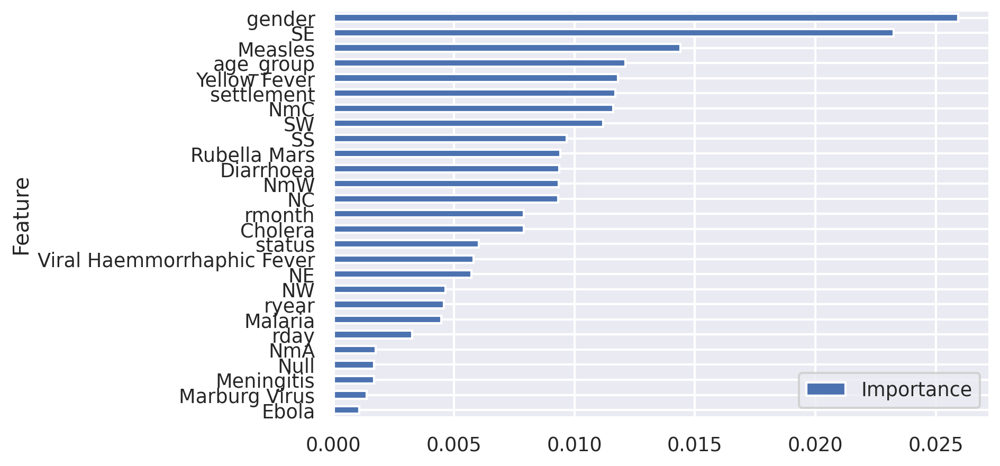

In [ ]:
coefficients = lr.coef_[0]
# avg_importance = np.mean(np.abs(coefficients), axis=0)
feature_importance = pd.DataFrame({'Feature': X.columns, 'Importance': np.abs(coefficients)})
feature_importance = feature_importance.sort_values('Importance', ascending=True)
feature_importance.plot(x='Feature', y='Importance', kind='barh', figsize=(8, 5))

In [ ]:
lr = LogisticRegression()
lr.fit(Xs_train, y_train)

# Get the coefficients
coefficients = lr.coef_[0]
intercept = lr.intercept_[0]

# Display the coefficients
print("Coefficients:")
for feature, coef in zip(X.columns, coefficients):
    print(f"{feature}: {coef}")

# Get the odds ratios
odds_ratios = np.exp(coefficients)

# Display the odds ratios
print("\nOdds Ratios:")
for feature, odds_ratio in zip(X.columns, odds_ratios):
    print(f"{feature}: {odds_ratio}")

# Optionally, you can also display the intercept
print("\nIntercept:", intercept)

Coefficients:
gender: -0.025965549923062135
settlement: 0.011714849593778621
status: -0.006063192468764034
ryear: -0.004550839347156406
rmonth: -0.00792398148377595
rday: 0.0032802452171958813
age_group: -0.012109390065690794
NC: 0.009311696429962081
NE: -0.005709455790346153
NW: -0.004636975758957009
SE: 0.023182835922671143
SS: -0.009653730514186228
SW: -0.011156645488332863
NmA: -0.001741343701997226
NmC: 0.011587408931568493
NmW: -0.009327258840633275
Null: 0.0016738337056630746
Cholera: 0.007882656857638589
Diarrhoea: -0.009355468561963108
Ebola: -0.001054785614882639
Malaria: 0.0044723477579031515
Marburg Virus: -0.0013851253197240273
Measles: -0.014345452618446376
Meningitis: -0.0016738337056630772
Rubella Mars: 0.009362179308823009
Viral Haemmorrhaphic Fever: -0.005792475133749432
Yellow Fever: 0.011761902445608046

Odds Ratios:
gender: 0.9743686561057305
settlement: 1.0117837371840521
status: 0.9939551515894491
ryear: 0.9954595000319947
rmonth: 0.9921073304977305
rday: 1.00328

In [ ]:
# Get coefficients and intercept
coefficients = lr.coef_[0]
intercept = lr.intercept_

In [ ]:
# Plot decision boundary
x_values = np.linspace(np.min(Xs_train), np.max(Xs_train), 100)
y_values = -(coefficients[0] / coefficients[1]) * x_values - (intercept / coefficients[1])

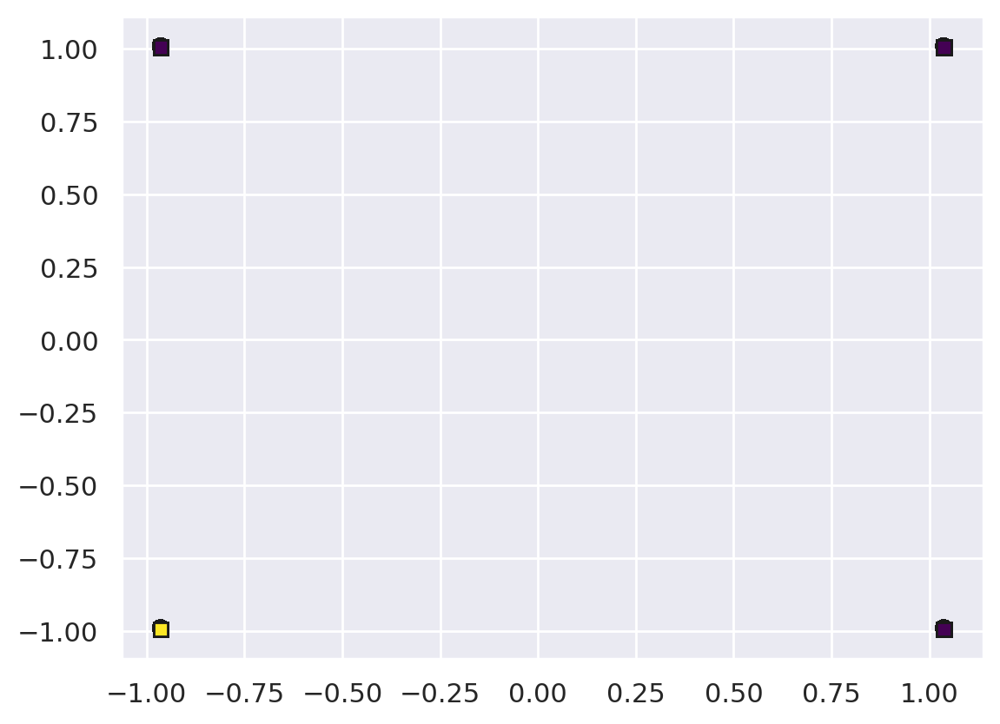

In [ ]:
# Plot the data points
plt.scatter(Xs_train[:, 0], Xs_train[:, 1], c=y_train, cmap='viridis', edgecolors='k', marker='o', label='Training Data')
plt.scatter(Xs_test[:, 0], Xs_test[:, 1], c=y_test, cmap='viridis', edgecolors='k', marker='s', label='Test Data')

In [ ]:
# Get coefficients (m) and intercept (c)
m = lr.coef_[0]
c = lr.intercept_

In [ ]:
x_values = np.linspace(-5, 5, 27)

In [ ]:
# Calculate corresponding y values
y_values = m * x_values + c

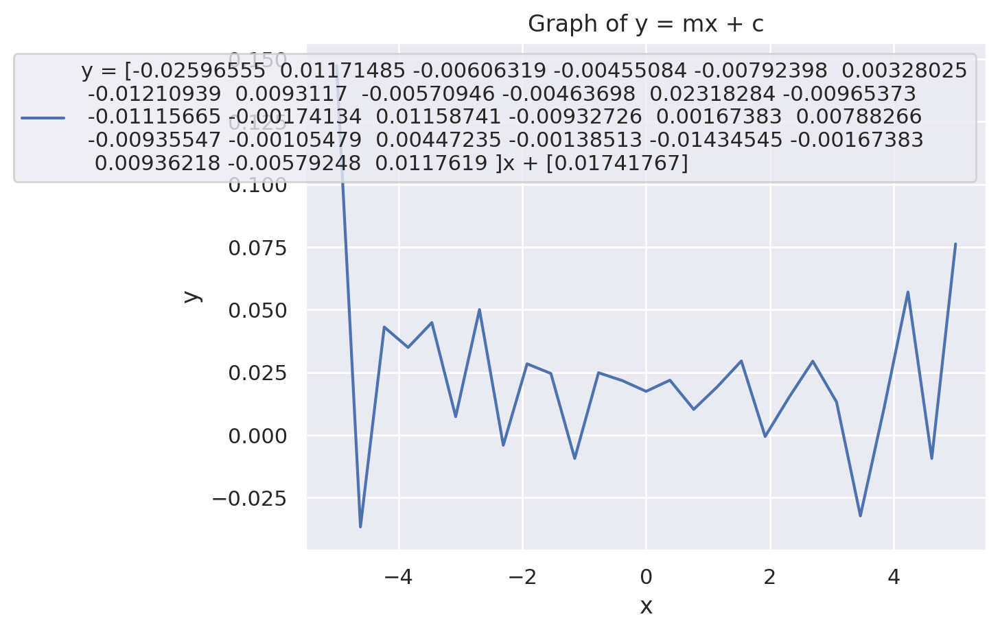

In [ ]:
# Plot the graph
plt.plot(x_values, y_values, label=f'y = {m}x + {c}')
plt.title('Graph of y = mx + c')
plt.xlabel('x')
plt.ylabel('y')
plt.legend()
plt.grid(True)
plt.show()

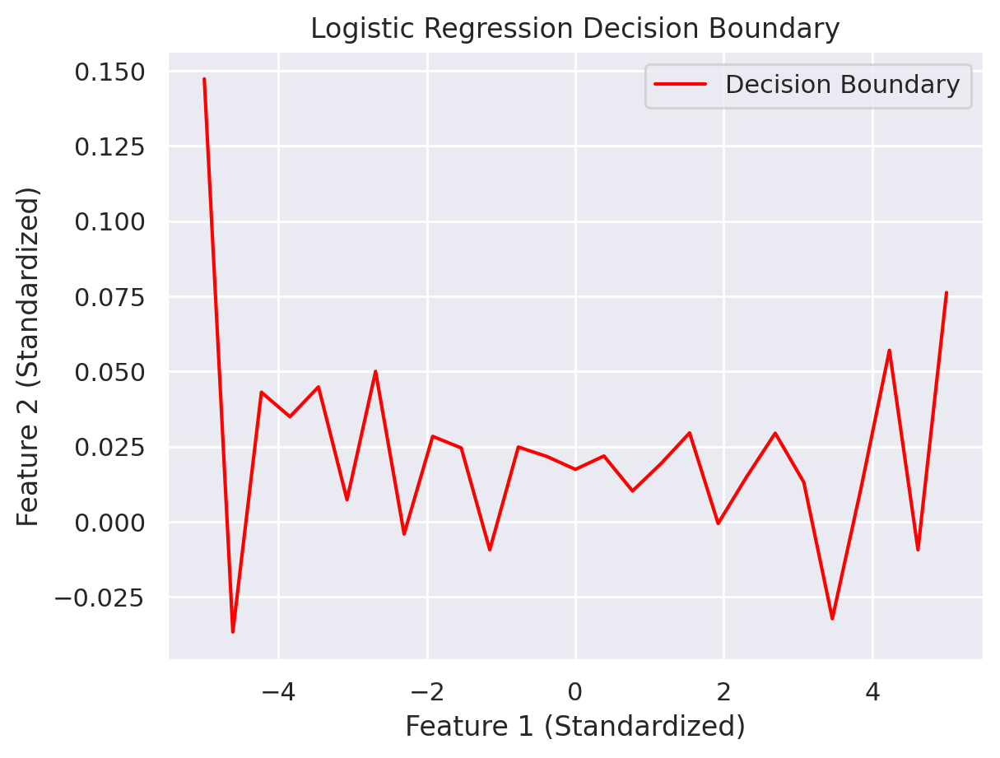

In [ ]:
# Plot decision boundary
plt.plot(x_values, y_values, label='Decision Boundary', color='red')

# Set plot labels and legend
plt.title('Logistic Regression Decision Boundary')
plt.xlabel('Feature 1 (Standardized)')
plt.ylabel('Feature 2 (Standardized)')
plt.legend()

# Show the plot
plt.show()

In [ ]:
from sklearn.metrics import roc_curve, auc, roc_auc_score

y_scores = lr.predict_proba(Xs_test)[:, 1]

# Compute ROC curve and ROC area for each class
fpr, tpr, _ = roc_curve(y_test, y_scores)
roc_auc = auc(fpr, tpr)

roc_auc_score_value = roc_auc_score(y_test, y_scores)

# Print the AUC value
print("AUC:", roc_auc)

# Plot ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = {:.2f})'.format(roc_auc))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()

# Display the AUC value obtained directly from roc_auc_score
print("AUC (roc_auc_score):", roc_auc_score_value)

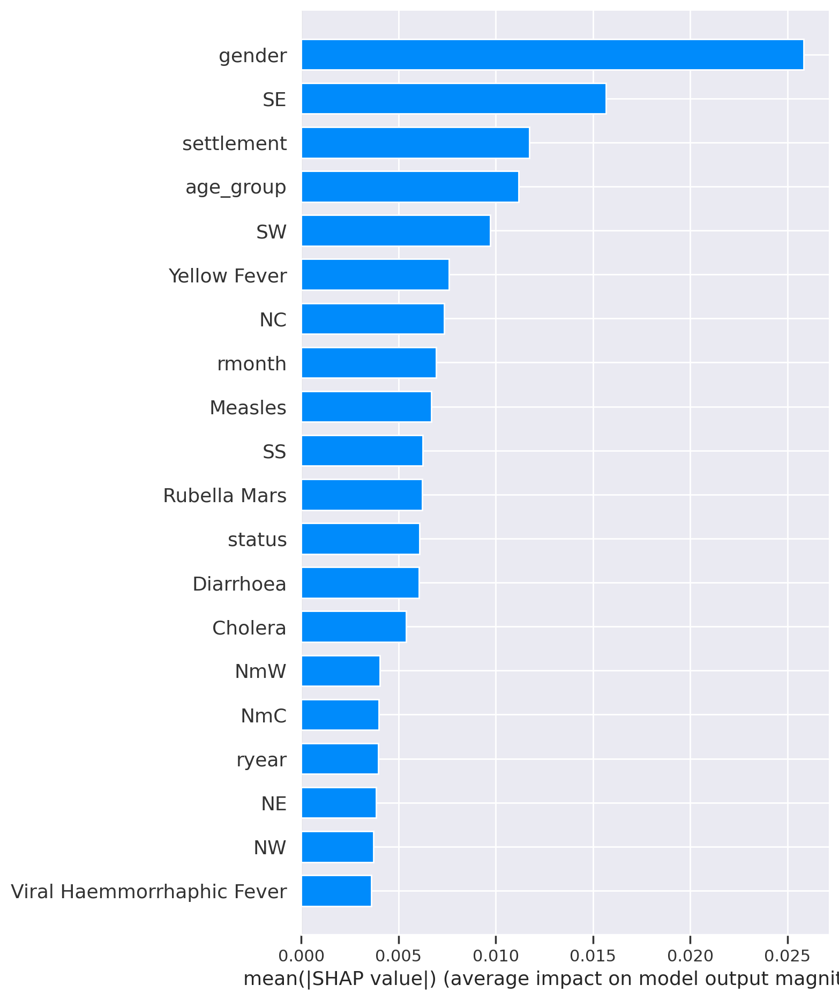

In [ ]:
columns = ['gender', 'settlement', 'status', 'ryear', 'rmonth', 'rday', 'age_group',
           'NC', 'NE', 'NW', 'SE', 'SS', 'SW', 'NmA', 'NmC', 'NmW', 'Null', 'Cholera', 'Diarrhoea',
           'Ebola', 'Malaria', 'Marburg Virus', 'Measles', 'Meningitis', 'Rubella Mars',
           'Viral Haemmorrhaphic Fever', 'Yellow Fever']

# Creating the DataFrame
Xs_train_df = pd.DataFrame(Xs_train, columns=columns)

# Using SHAP to explain the predictions made by the Logistic Regression model
explainer = shap.LinearExplainer(model=lr, data=Xs_train_df, masker=shap.maskers.Independent(Xs_train_df))
shap_values = explainer.shap_values(Xs_test)

# Getting the feature names from the DataFrame
feature_names = Xs_train_df.columns

# Plotting a summary bar plot with the exact feature names
shap.summary_plot(shap_values, Xs_test, feature_names=feature_names, plot_type="bar")

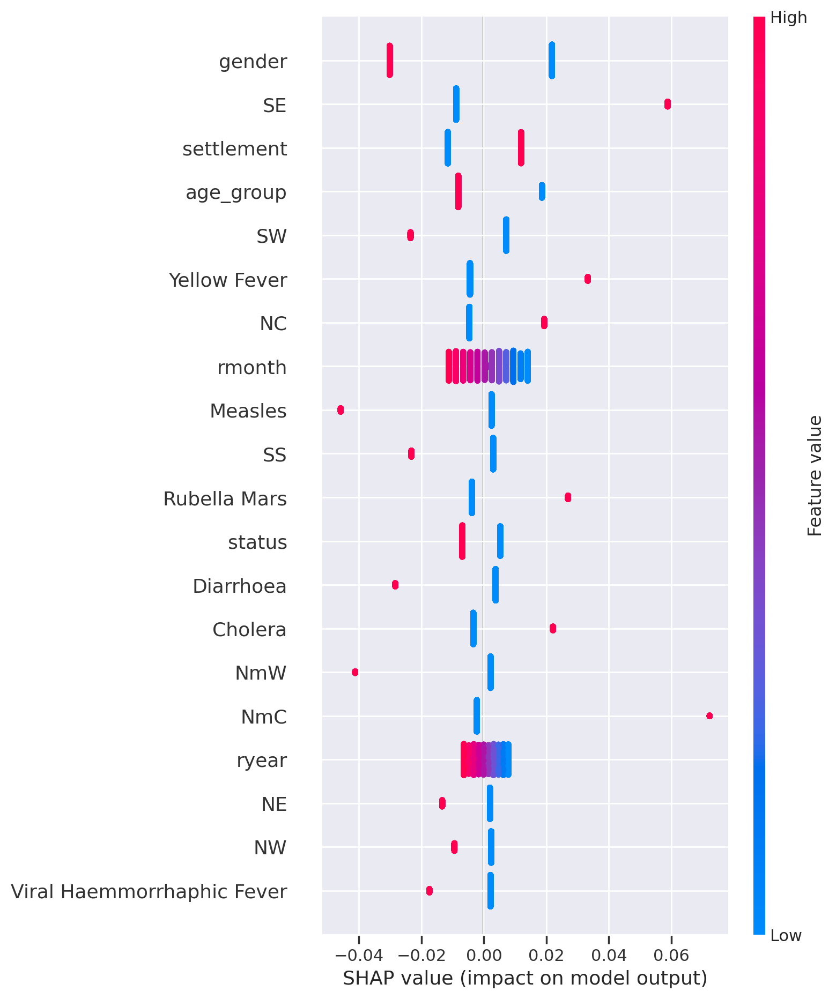

In [ ]:
shap.summary_plot(shap_values, Xs_test, feature_names=feature_names)

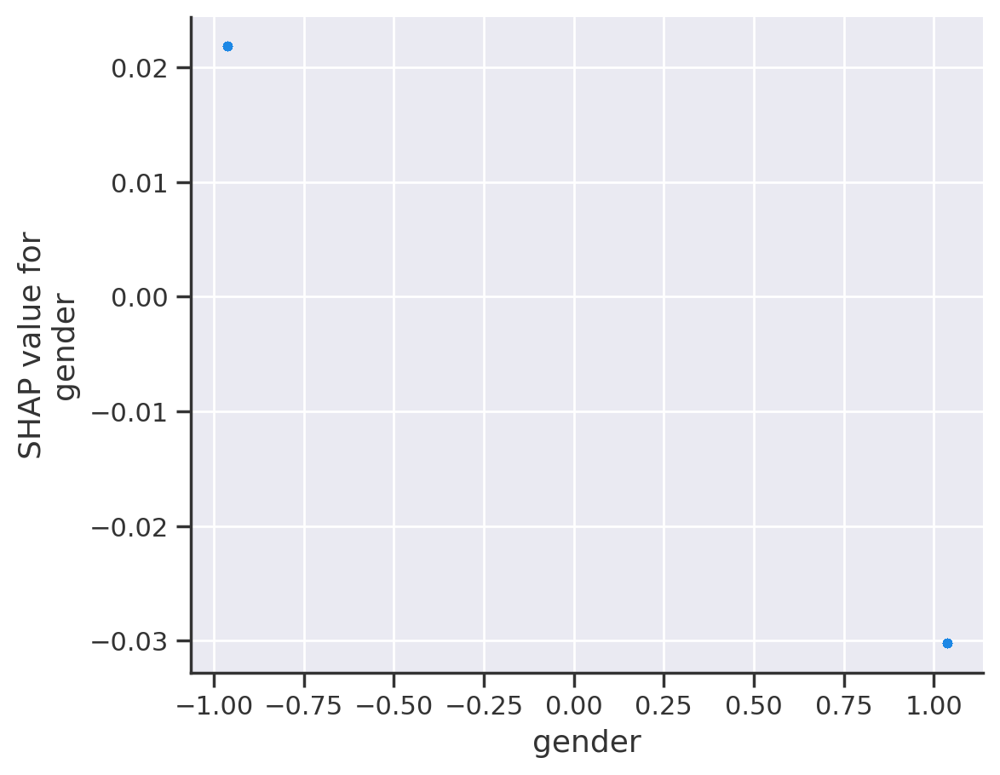

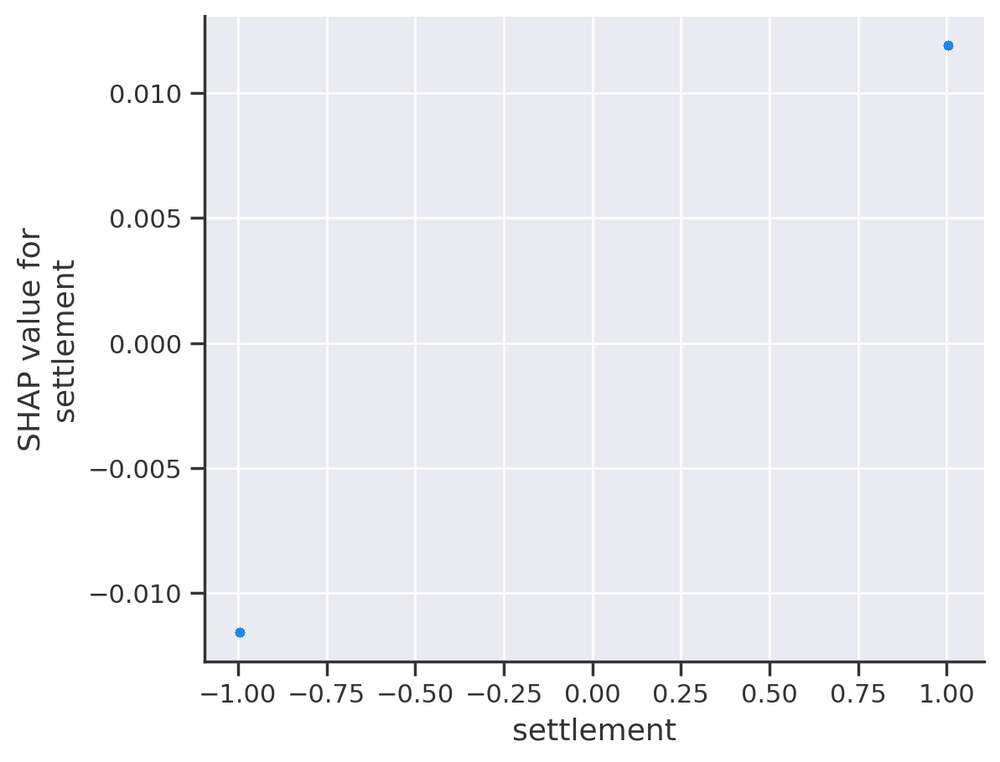

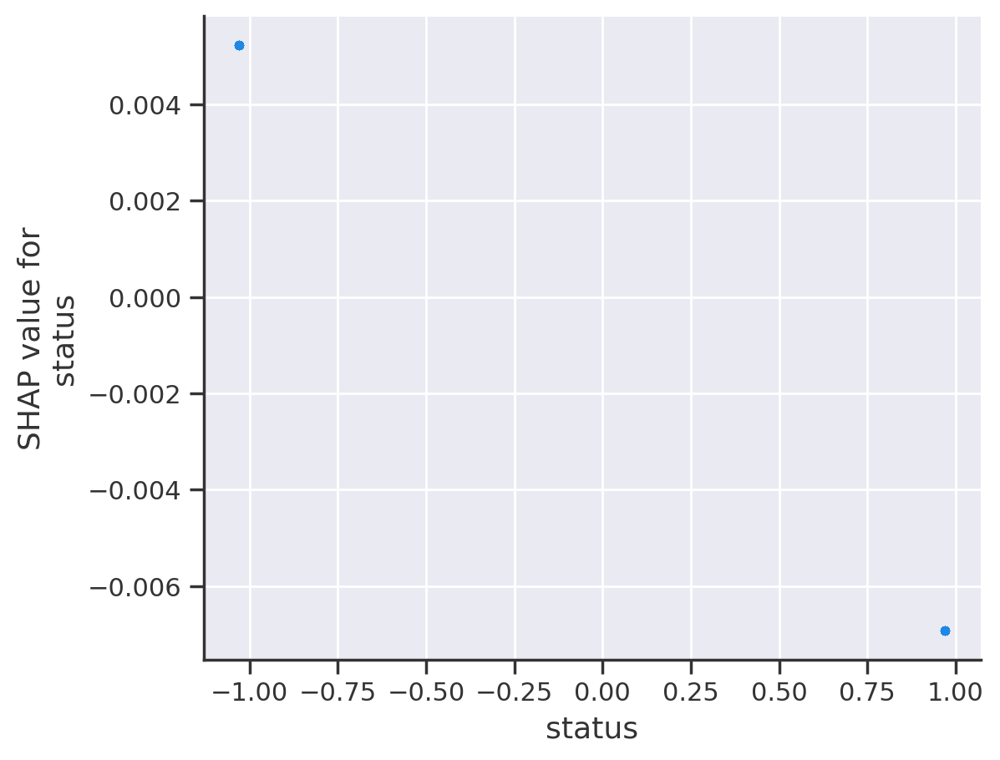

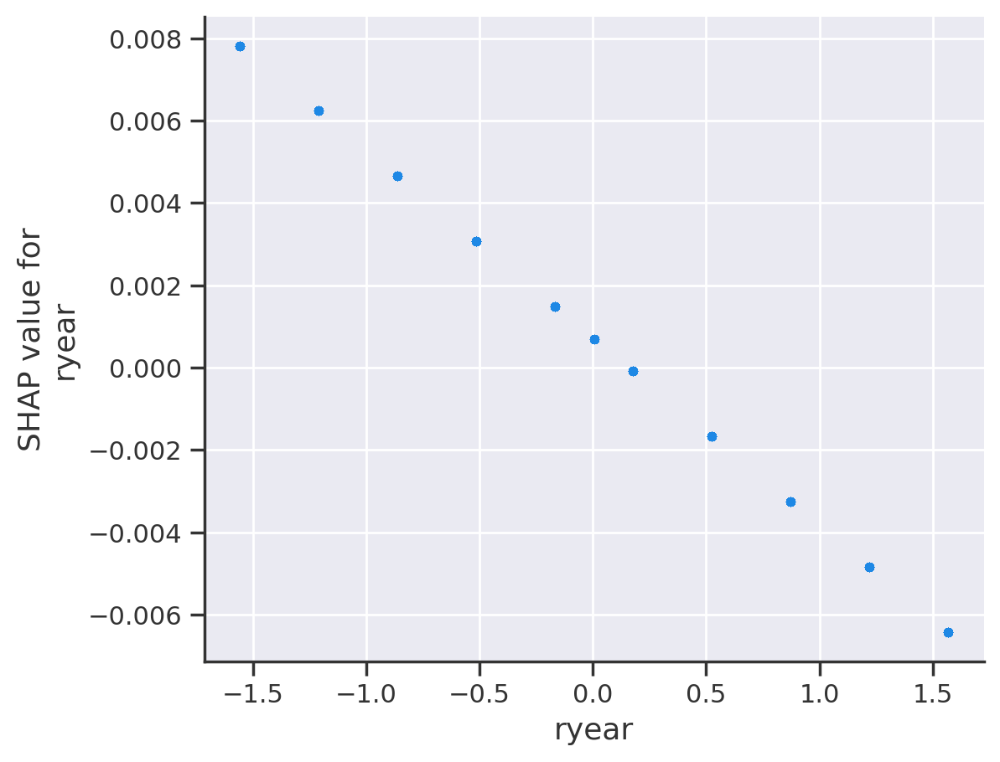

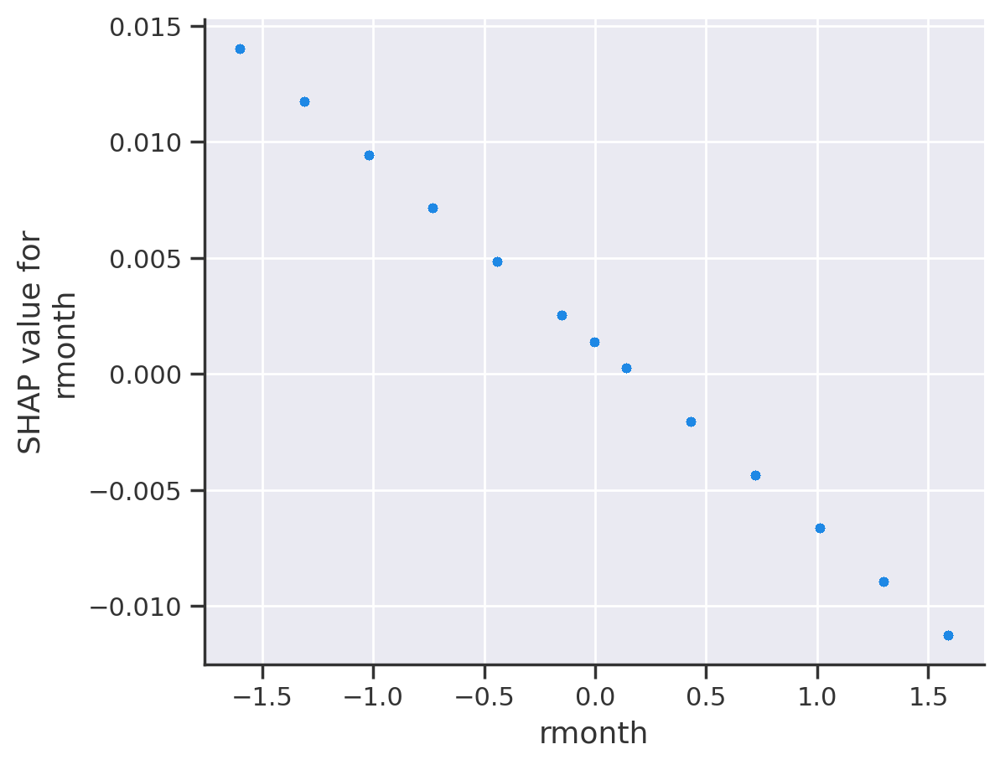

...

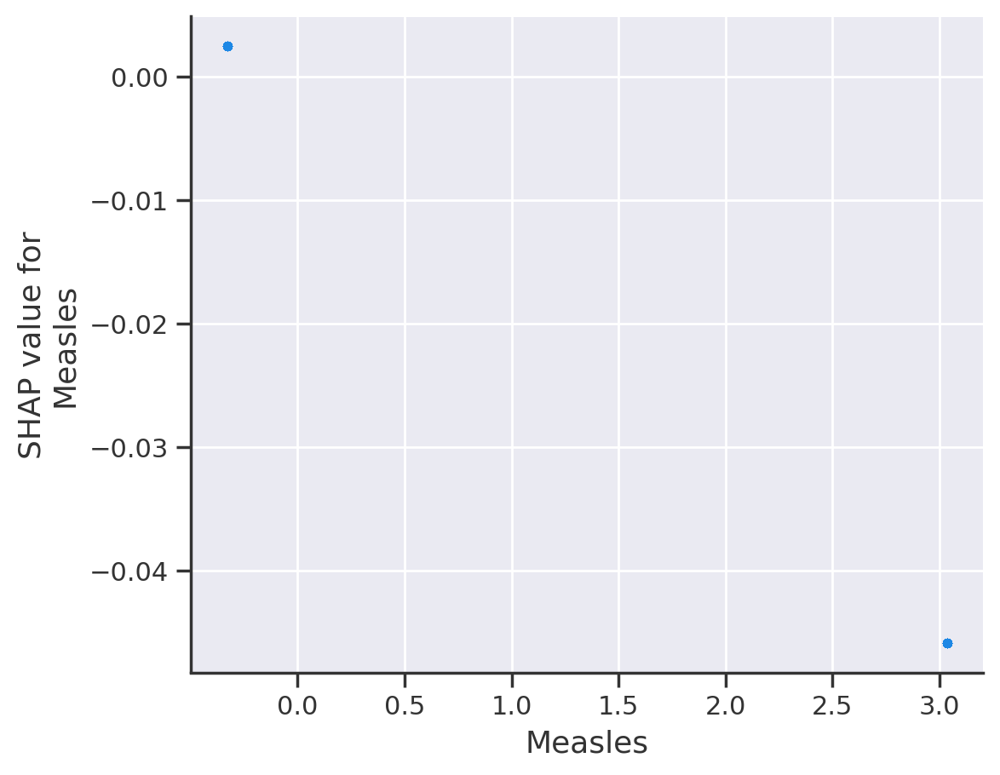

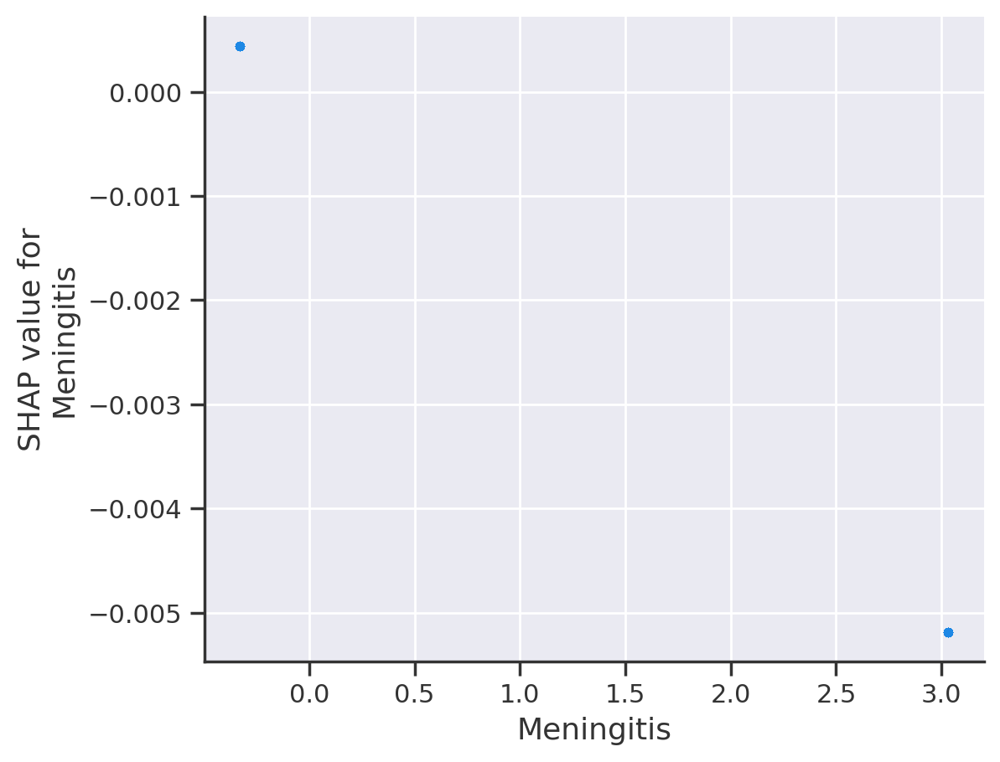

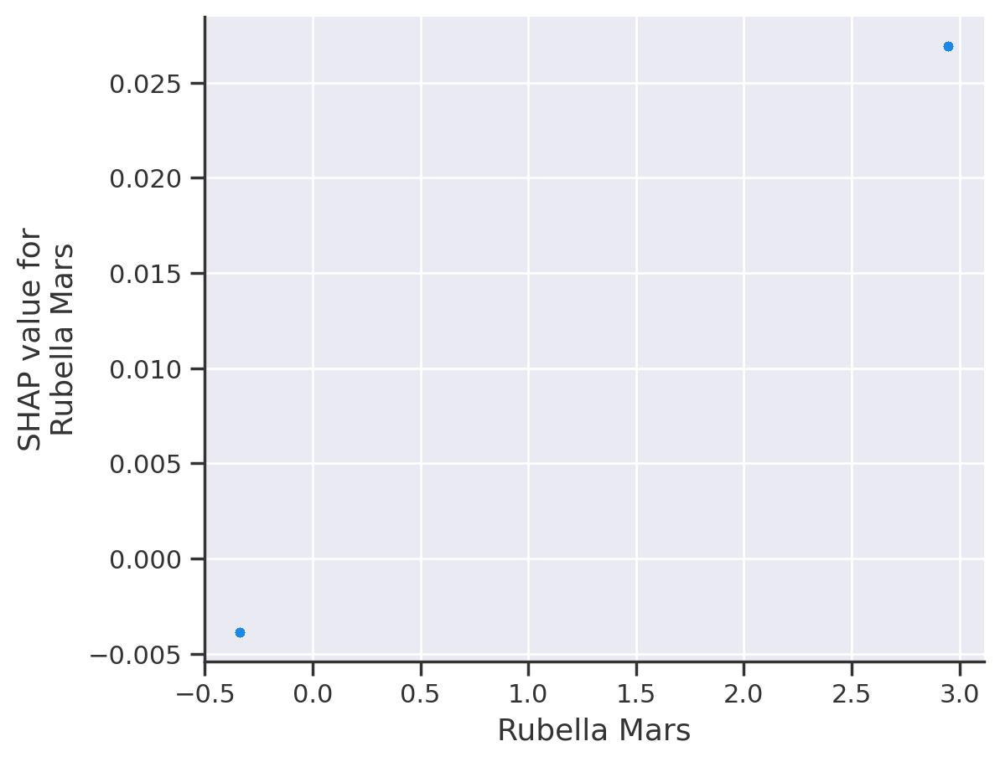

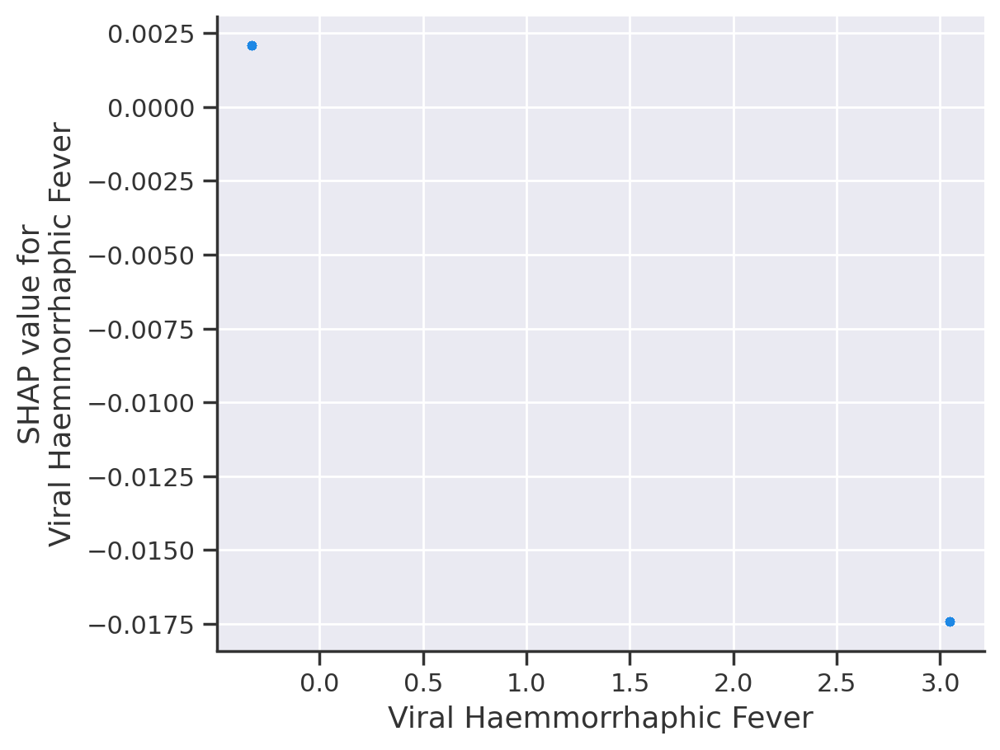

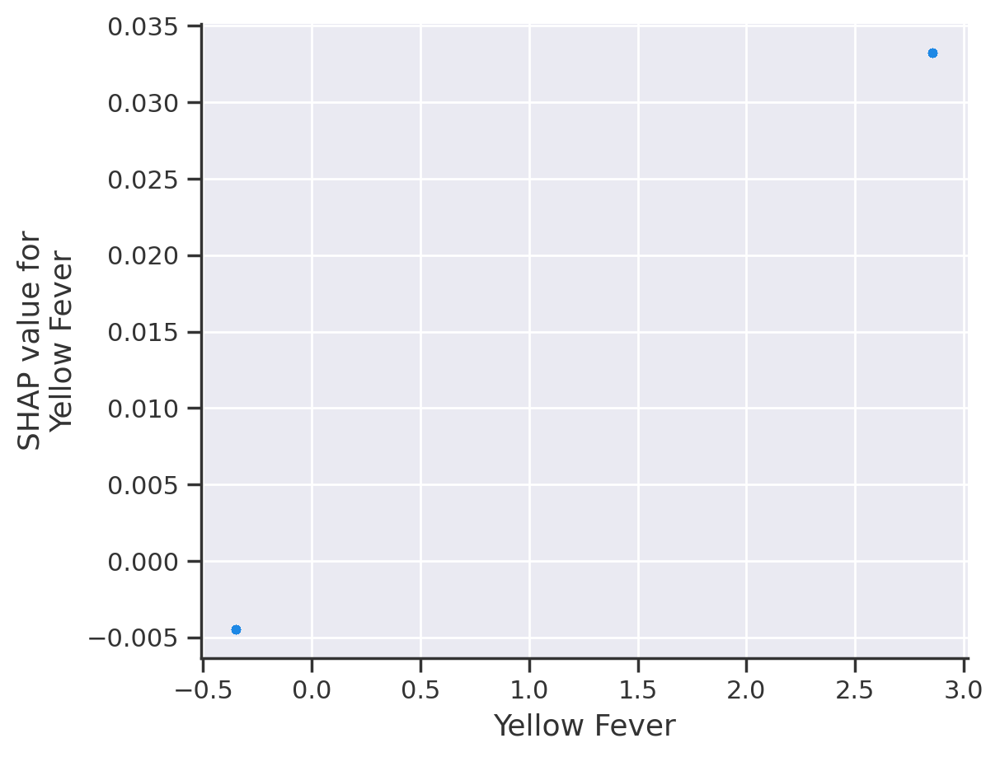

In [ ]:
# Iterate over each feature and create SHAP dependency plots
for feature_name in feature_names:
    shap.dependence_plot(feature_name, shap_values, Xs_test, feature_names=feature_names, interaction_index=None)

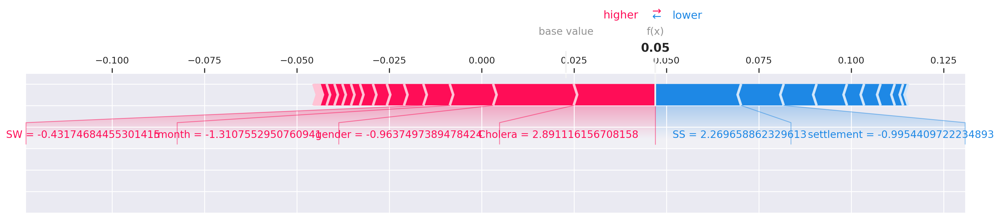

In [ ]:
# Choose a specific instance from your test data
instance_index = 0

# Creating a SHAP force plot for the selected instance
shap.force_plot(
    explainer.expected_value,
    shap_values[instance_index, :],
    Xs_test[instance_index, :],
    feature_names=feature_names,
    matplotlib=True
)

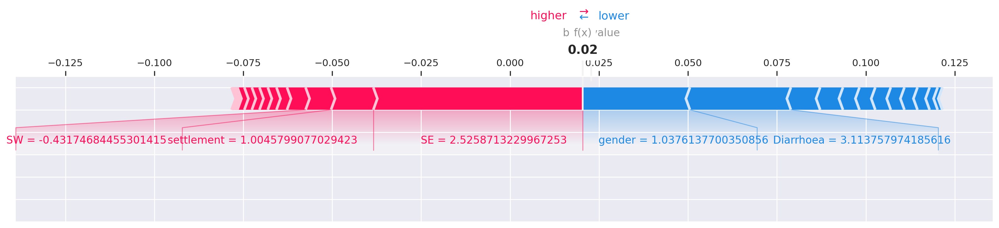

In [ ]:
# Choose a specific instance from your test data
instance_index = 4

# Creating a SHAP force plot for the selected instance
shap.force_plot(
    explainer.expected_value,
    shap_values[instance_index, :],
    Xs_test[instance_index, :],
    feature_names=feature_names,
    matplotlib=True
)

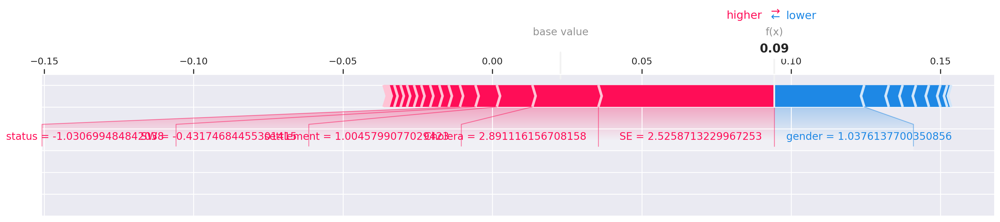

In [ ]:
# Choosing a specific instance from your test data
instance_index = 27

# Creating a SHAP force plot for the selected instance
shap.force_plot(
    explainer.expected_value,
    shap_values[instance_index, :],
    Xs_test[instance_index, :],
    feature_names=feature_names,
    matplotlib=True
)

In [ ]:
Xs_test.shape

(5690, 27)

In [ ]:
Xs_train.shape

(22758, 27)

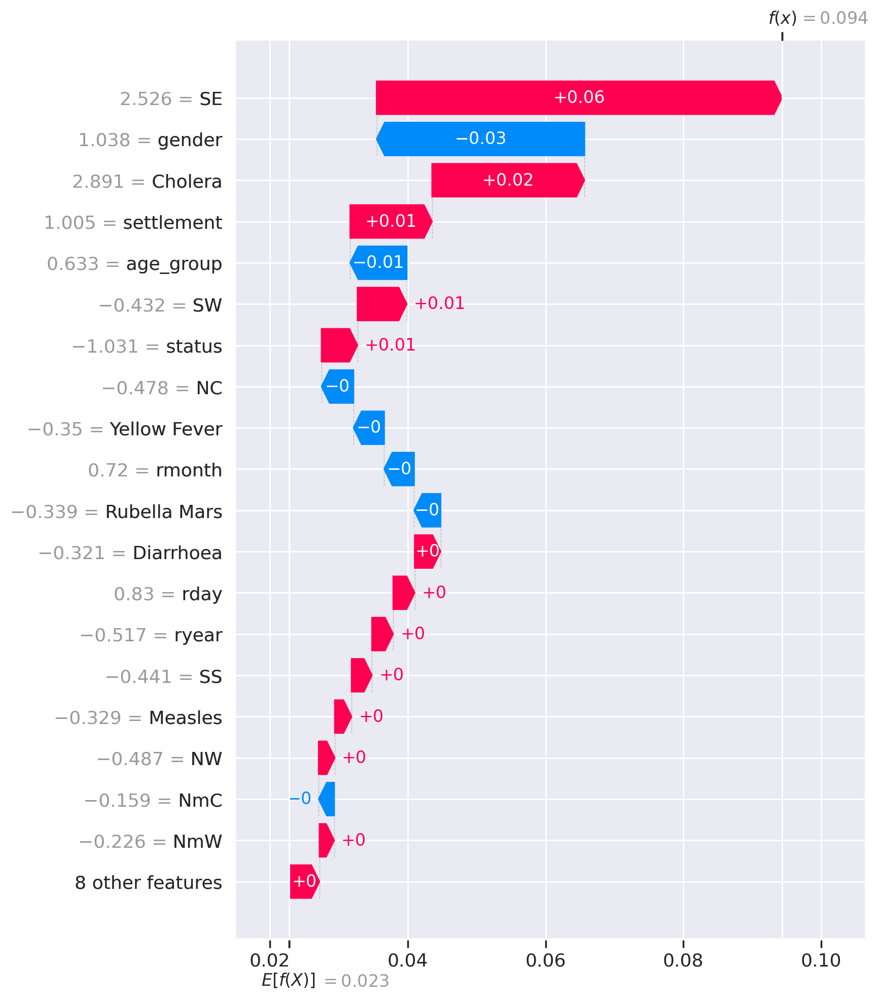

In [ ]:
# Choosing a specific instance from your test data
sample_ind = 27

# Creating an Explanation object
explanation = shap.Explanation(values=shap_values[sample_ind],
                               base_values=explainer.expected_value,
                               data=Xs_test[sample_ind, :],
                               feature_names=feature_names)

# Generating the waterfall plot
shap.plots.waterfall(explanation, max_display=20)

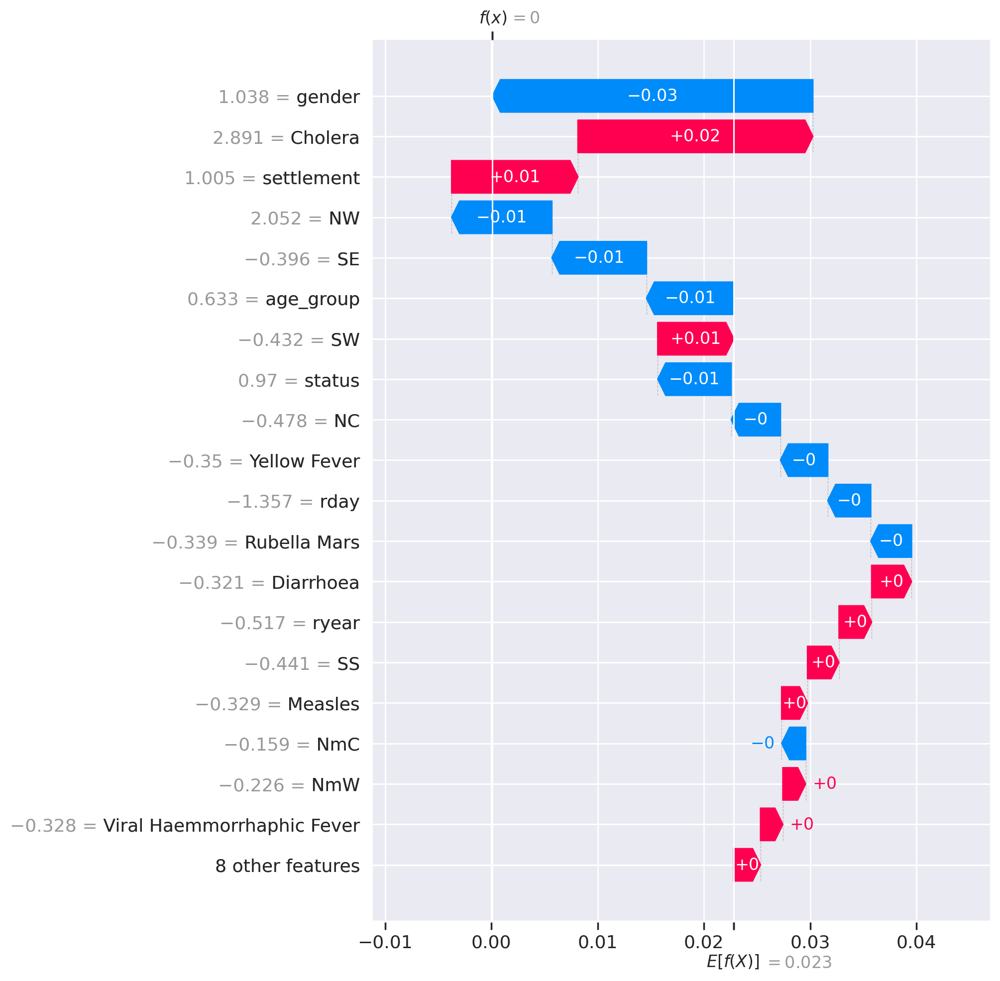

In [ ]:
# Choosing a specific instance from your test data
sample_ind = 10

# Creating an Explanation object
explanation = shap.Explanation(values=shap_values[sample_ind],
                               base_values=explainer.expected_value,
                               data=Xs_test[sample_ind, :],
                               feature_names=feature_names)

# Generating the waterfall plot
shap.plots.waterfall(explanation, max_display=20)

In [ ]:
import lime
from lime.lime_tabular import LimeTabularExplainer

columns = ['gender', 'settlement', 'status', 'ryear', 'rmonth', 'rday', 'age_group',
           'NC', 'NE', 'NW', 'SE', 'SS', 'SW', 'NmA', 'NmC', 'NmW', 'Null', 'Cholera', 'Diarrhoea',
           'Ebola', 'Malaria', 'Marburg Virus', 'Measles', 'Meningitis', 'Rubella Mars',
           'Viral Haemmorrhaphic Fever', 'Yellow Fever']

# Creating the DataFrame
Xs_train_df = pd.DataFrame(Xs_train, columns=columns)

# Using LIME to explain a prediction
explainer = LimeTabularExplainer(Xs_train_df.values, feature_names=Xs_train_df.columns, class_names=['0', '1'], discretize_continuous=True)

In [ ]:
instance_to_explain = Xs_test[0, :]
explanation = explainer.explain_instance(instance_to_explain, lr.predict_proba, num_features=len(Xs_train[0]))

In [ ]:
# Print the explanation
explanation.show_in_notebook(show_table=True, show_all=False)

# **K-Nearest Neighbor**

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

knn = KNeighborsClassifier(n_neighbors=2)
knn.fit(X_train, y_train)

KNeighborsClassifier(n_neighbors=2)

In [ ]:
print("{} NN Score: {:.2f}%".format(2, knn.score(X_test, y_test)*100))

2 NN Score: 50.11%


In [ ]:
# Make predictions
y_pred_knn = knn_model.predict(X_test)

# Evaluate accuracy
accuracy = accuracy_score(y_test, y_pred_knn)
print(f"Accuracy: {accuracy}")

In [ ]:
# Print the classification report
print(classification_report(y_pred_knn, y_test))

              precision    recall  f1-score   support

           0       0.75      0.50      0.60      4263
           1       0.25      0.50      0.34      1427

    accuracy                           0.50      5690
   macro avg       0.50      0.50      0.47      5690
weighted avg       0.63      0.50      0.54      5690



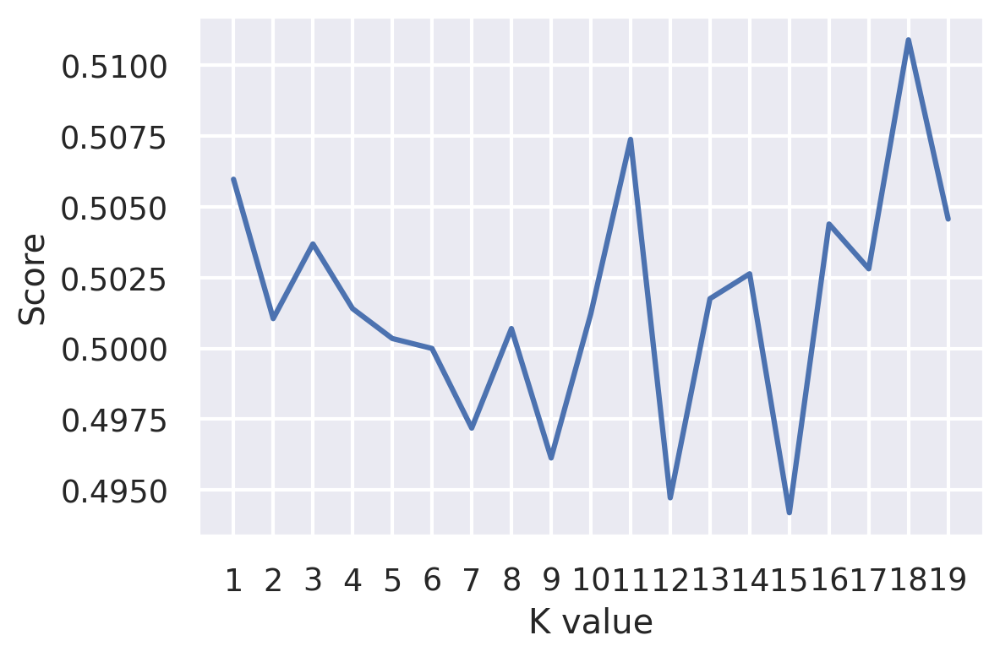

Maximum KNN Score is 51.09%


In [ ]:
scoreList = []
accuracies = {}
for i in range(1,20):
    knn2 = KNeighborsClassifier(n_neighbors=i)
    knn2.fit(X_train, y_train)
    scoreList.append(knn2.score(X_test, y_test))

plt.plot(range(1,20), scoreList)
plt.xticks(np.arange(1,20,1))
plt.xlabel("K value")
plt.ylabel("Score")
plt.show()

acc = max(scoreList)*100
accuracies['KNN'] = acc
print("Maximum KNN Score is {:.2f}%".format(acc))

In [ ]:
# Defining the KNN model
knn = KNeighborsClassifier()

# Defining hyperparameters and their possible values for tuning
param_grid = {
    'n_neighbors': np.arange(1, 21),
    'weights': ['uniform', 'distance'],
    'p': [1, 2]  # 1 for Manhattan distance (L1), 2 for Euclidean distance (L2)
}

# Performing grid search with cross-validation
grid_search = GridSearchCV(knn, param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, y_train)

# Getting the best hyperparameters
best_params = grid_search.best_params_
print("Best Hyperparameters:", best_params)

# Evaluating the model with the best hyperparameters on the test set
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Test Accuracy:", accuracy)

Best Hyperparameters: {'n_neighbors': 13, 'p': 1, 'weights': 'uniform'}
Test Accuracy: 0.4982425307557118


In [ ]:
knn = KNeighborsClassifier(n_neighbors=2)
knn.fit(X_train, y_train)

KNeighborsClassifier(n_neighbors=2)

<Axes: ylabel='Feature'>

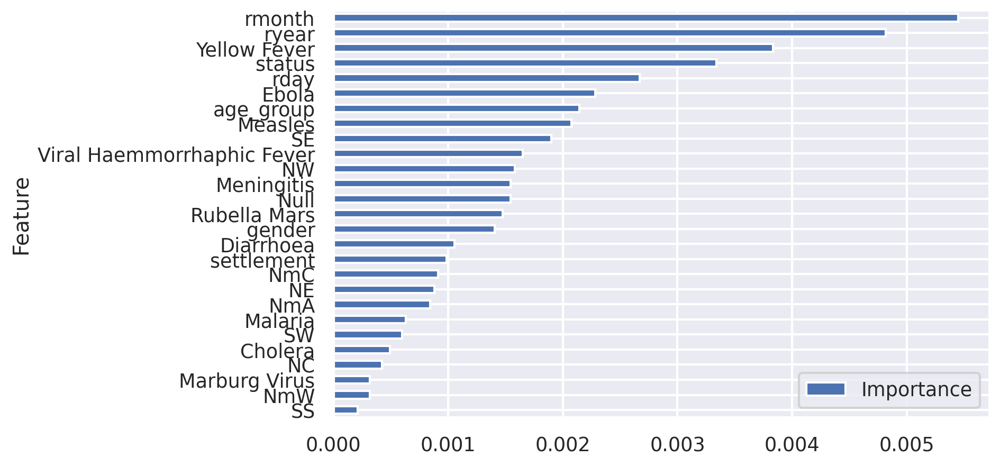

In [ ]:
kfimps = permutation_importance(knn, X_test, y_test)
# avg_importance = np.mean(np.abs(coefficients), axis=0)
feature_importance = pd.DataFrame({'Feature': X.columns, 'Importance': np.abs(kfimps.importances_mean)})
feature_importance = feature_importance.sort_values('Importance', ascending=True)
feature_importance.plot(x='Feature', y='Importance', kind='barh', figsize=(8, 5))

AUC for KNN: 0.49769230769230766


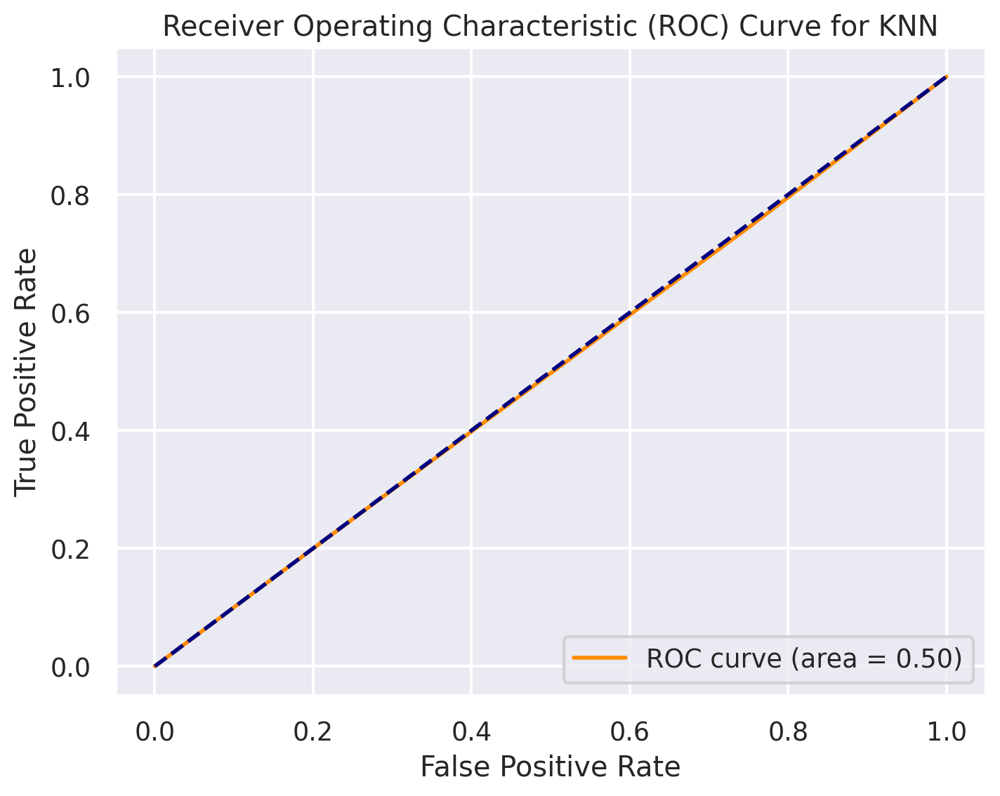

AUC (roc_auc_score) for KNN: 0.49769230769230766


In [ ]:
from sklearn.metrics import roc_curve, auc, roc_auc_score

# Get predicted probabilities for positive class
y_scores_knn = knn.predict_proba(X_test)[:, 1]

# Compute ROC curve and ROC area for each class
fpr_knn, tpr_knn, _ = roc_curve(y_test, y_scores_knn)
roc_auc_knn = auc(fpr_knn, tpr_knn)

roc_auc_score_value_knn = roc_auc_score(y_test, y_scores_knn)

# Print the AUC value for KNN
print("AUC for KNN:", roc_auc_knn)

# Plot ROC curve for KNN
plt.figure(figsize=(8, 6))
plt.plot(fpr_knn, tpr_knn, color='darkorange', lw=2, label='ROC curve (area = {:.2f})'.format(roc_auc_knn))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve for KNN')
plt.legend(loc='lower right')
plt.show()

# Display the AUC value obtained directly from roc_auc_score for KNN
print("AUC (roc_auc_score) for KNN:", roc_auc_score_value_knn)

In [ ]:
columns = ['gender', 'settlement', 'status', 'ryear', 'rmonth', 'rday', 'age_group',
           'NC', 'NE', 'NW', 'SE', 'SS', 'SW', 'NmA', 'NmC', 'NmW', 'Null', 'Cholera', 'Diarrhoea',
           'Ebola', 'Malaria', 'Marburg Virus', 'Measles', 'Meningitis', 'Rubella Mars',
           'Viral Haemmorrhaphic Fever', 'Yellow Fever']

# Creating the DataFrame
X_train_df_knn = pd.DataFrame(X_train, columns=columns)

# Using SHAP to explain the predictions made by the KNN model
explainer_knn = shap.KernelExplainer(model=knn.predict_proba, data=X_train_df_knn)
shap_values_knn = explainer_knn.shap_values(X_test)

# Getting the feature names from the DataFrame
feature_names_knn = X_train_df_knn.columns

# Plotting a summary bar plot with the exact feature names for KNN
shap.summary_plot(shap_values_knn, X_test, feature_names=feature_names_knn, plot_type="bar")

  0%|          | 0/5690 [00:00<?, ?it/s]

In [ ]:
shap.summary_plot(shap_values_knn, Xs_test, feature_names=feature_names_knn)

In [ ]:
instance_index_knn = 0

# Creating a SHAP force plot for the selected instance
shap.force_plot(
    explainer_knn.expected_value[1],
    shap_values_knn[instance_index_knn, :],
    X_test[instance_index_knn, :],
    feature_names=feature_names_knn,
    matplotlib=True
)

plt.show()

In [ ]:
# Choosing a specific instance from your test data
sample_ind_knn = 27

# Creating an Explanation object for KNN
explanation_knn = shap.Explanation(values=shap_values_knn[sample_ind_knn],
                                    base_values=explainer_knn.expected_value[1],
                                    data=X_test[sample_ind_knn, :],
                                    feature_names=feature_names_knn)

# Generating the waterfall plot for KNN
shap.plots.waterfall(explanation_knn, max_display=20)
plt.show()

In [ ]:
import lime
from lime.lime_tabular import LimeTabularExplainer

columns = ['gender', 'settlement', 'status', 'ryear', 'rmonth', 'rday', 'age_group',
           'NC', 'NE', 'NW', 'SE', 'SS', 'SW', 'NmA', 'NmC', 'NmW', 'Null', 'Cholera', 'Diarrhoea',
           'Ebola', 'Malaria', 'Marburg Virus', 'Measles', 'Meningitis', 'Rubella Mars',
           'Viral Haemmorrhaphic Fever', 'Yellow Fever']

# Converting X_train back to a Pandas DataFrame
X_train_df = pd.DataFrame(X_train, columns=X_train.columns)

# Using LIME to explain the prediction
explainer = LimeTabularExplainer(X_train_df.values, feature_names=X_train_df.columns, class_names=['0', '1'], discretize_continuous=True)

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

knn = KNeighborsClassifier(n_neighbors=2)
knn.fit(X_train, y_train)

KNeighborsClassifier(n_neighbors=2)

In [ ]:
instance_to_explain = X_test.iloc[0, :].values

explanation = explainer.explain_instance(
    instance_to_explain, knn.predict_proba, num_features=len(X_train.columns)
)

In [ ]:
# Print the explanation
explanation.show_in_notebook(show_table=True, show_all=False)

# **Support Vector Classifier**

In [ ]:
from sklearn.svm import SVC

svm = SVC(kernel='linear')
svm.fit(X_train, y_train)

acc = svm.score(X_test, y_test)*100
accuracies['SVM'] = acc
print("Test Accuracy  of SVM Algorithm: {:.2f}%".format(acc))

Test Accuracy  of SVM Algorithm: 51.25%


In [ ]:
# Make predictions
y_pred_svm = svm.predict(X_test)

# Print the classification report
print(classification_report(y_pred_svm, y_test))

              precision    recall  f1-score   support

           0       0.51      0.52      0.51      2848
           1       0.51      0.51      0.51      2842

    accuracy                           0.51      5690
   macro avg       0.51      0.51      0.51      5690
weighted avg       0.51      0.51      0.51      5690



In [ ]:
# Defining hyperparameters and their possible values for tuning
param_grid = {
    'C': [0.1, 1, 10, 100],
    'kernel': ['linear', 'rbf', 'poly', 'sigmoid'],
    'gamma': ['scale', 'auto'] + [0.1, 1, 10, 100]
}

# Performing grid search with cross-validation
grid_search = GridSearchCV(svm, param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, y_train)

# Getting the best hyperparameters
best_params = grid_search.best_params_
print("Best Hyperparameters:", best_params)

# Evaluating the model with the best hyperparameters on the test set
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Test Accuracy:", accuracy)

<Axes: ylabel='Feature'>

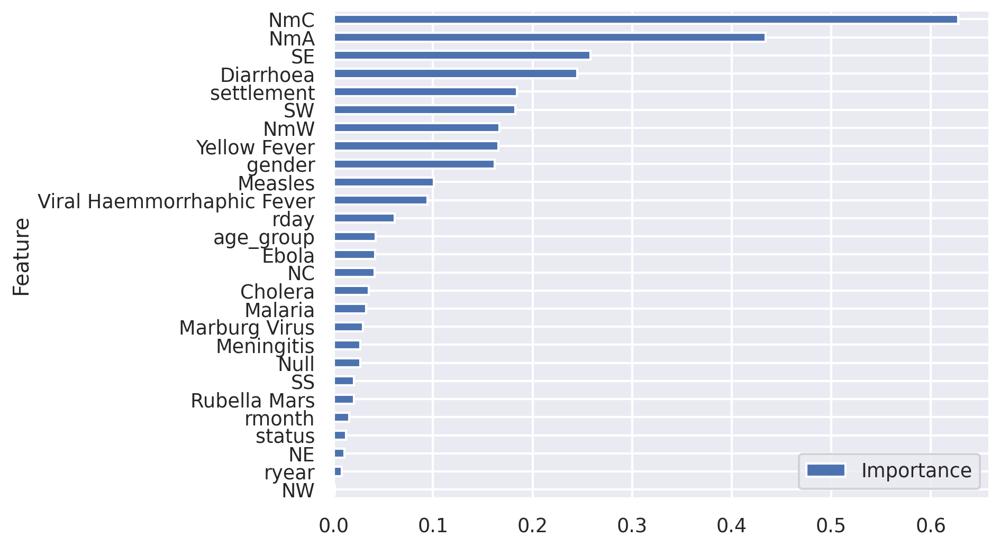

In [ ]:
coefficients = svm.coef_[0]
# avg_importance = np.mean(np.abs(coefficients), axis=0)
feature_importance = pd.DataFrame({'Feature': X.columns, 'Importance': np.abs(coefficients)})
feature_importance = feature_importance.sort_values('Importance', ascending=True)
feature_importance.plot(x='Feature', y='Importance', kind='barh', figsize=(8, 6))

AUC for SVM: 0.5155832241962984


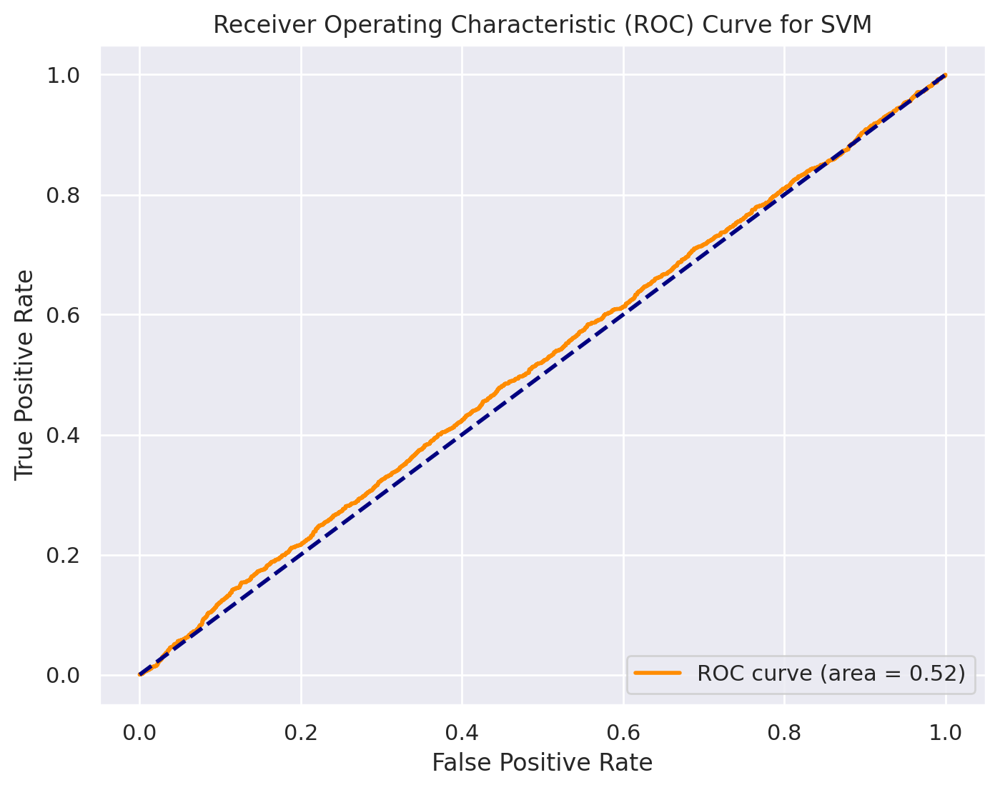

AUC (roc_auc_score) for SVM: 0.5155832241962984


In [ ]:
# Make predictions
y_pred_svm = svm.predict(X_test)

y_scores_svm = svm.decision_function(X_test)

# Compute ROC curve and ROC area for each class
fpr_svm, tpr_svm, _ = roc_curve(y_test, y_scores_svm)
roc_auc_svm = auc(fpr_svm, tpr_svm)

roc_auc_score_value_svm = roc_auc_score(y_test, y_scores_svm)

# Print the AUC value for SVM
print("AUC for SVM:", roc_auc_svm)

# Plot ROC curve for SVM
plt.figure(figsize=(8, 6))
plt.plot(fpr_svm, tpr_svm, color='darkorange', lw=2, label='ROC curve (area = {:.2f})'.format(roc_auc_svm))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve for SVM')
plt.legend(loc='lower right')
plt.show()

print("AUC (roc_auc_score) for SVM:", roc_auc_score_value_svm)

# **Naive Bayes Algorithm**

In [ ]:
from sklearn.naive_bayes import GaussianNB


gnb = GaussianNB()
gnb.fit(X_train, y_train)

acc = gnb.score(X_test, y_test)*100
accuracies['Naive Bayes'] = acc
print("Test Accuracy for Naive Bayes: {:.2f}%".format(acc))

Test Accuracy for Naive Bayes: 51.09%


In [ ]:
# Making predictions on the test data
predict = gnb.predict(X_test)

# Print the classification report
print(classification_report(y_test, predict))

              precision    recall  f1-score   support

           0       0.52      0.46      0.49      2860
           1       0.51      0.56      0.53      2830

    accuracy                           0.51      5690
   macro avg       0.51      0.51      0.51      5690
weighted avg       0.51      0.51      0.51      5690



<Axes: ylabel='Feature'>

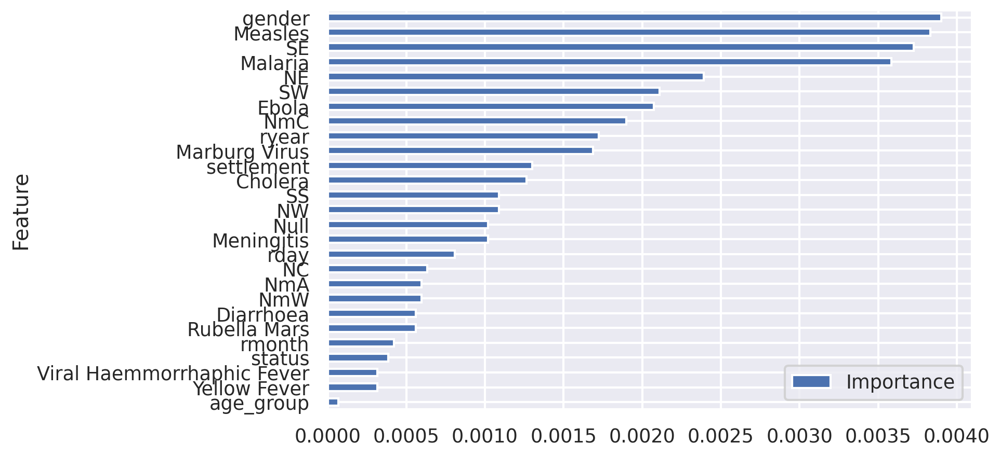

In [ ]:
imps = permutation_importance(gnb, X_test, y_test)
# avg_importance = np.mean(np.abs(coefficients), axis=0)
feature_importance = pd.DataFrame({'Feature': X.columns, 'Importance': np.abs(imps.importances_mean)})
feature_importance = feature_importance.sort_values('Importance', ascending=True)
feature_importance.plot(x='Feature', y='Importance', kind='barh', figsize=(8, 5))

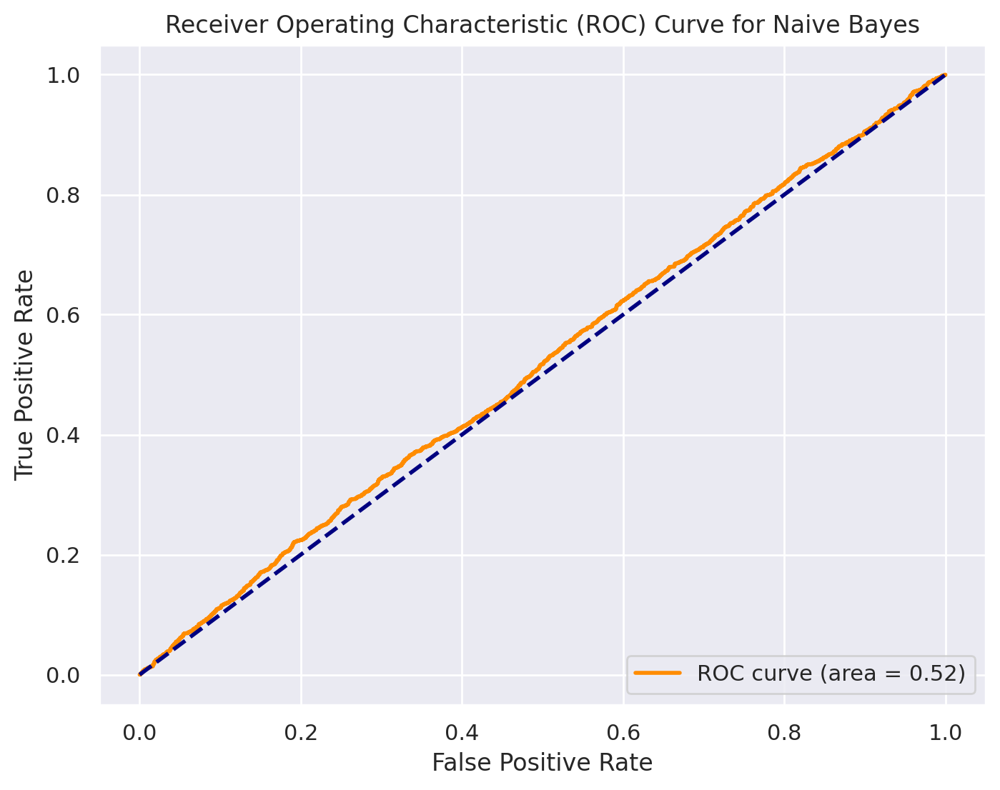

AUC for Naive Bayes: 0.5157505127381453


In [ ]:
from sklearn.metrics import roc_curve, auc

# Get predicted probabilities for the positive class
y_scores_gnb = gnb.predict_proba(X_test)[:, 1]

# Compute ROC curve and ROC area
fpr_gnb, tpr_gnb, thresholds_gnb = roc_curve(y_test, y_scores_gnb)
roc_auc_gnb = auc(fpr_gnb, tpr_gnb)

# Plot ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr_gnb, tpr_gnb, color='darkorange', lw=2, label='ROC curve (area = {:.2f})'.format(roc_auc_gnb))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve for Naive Bayes')
plt.legend(loc='lower right')
plt.show()

# Print the AUC value for Naive Bayes
print("AUC for Naive Bayes:", roc_auc_gnb)

  0%|          | 0/5690 [00:00<?, ?it/s]

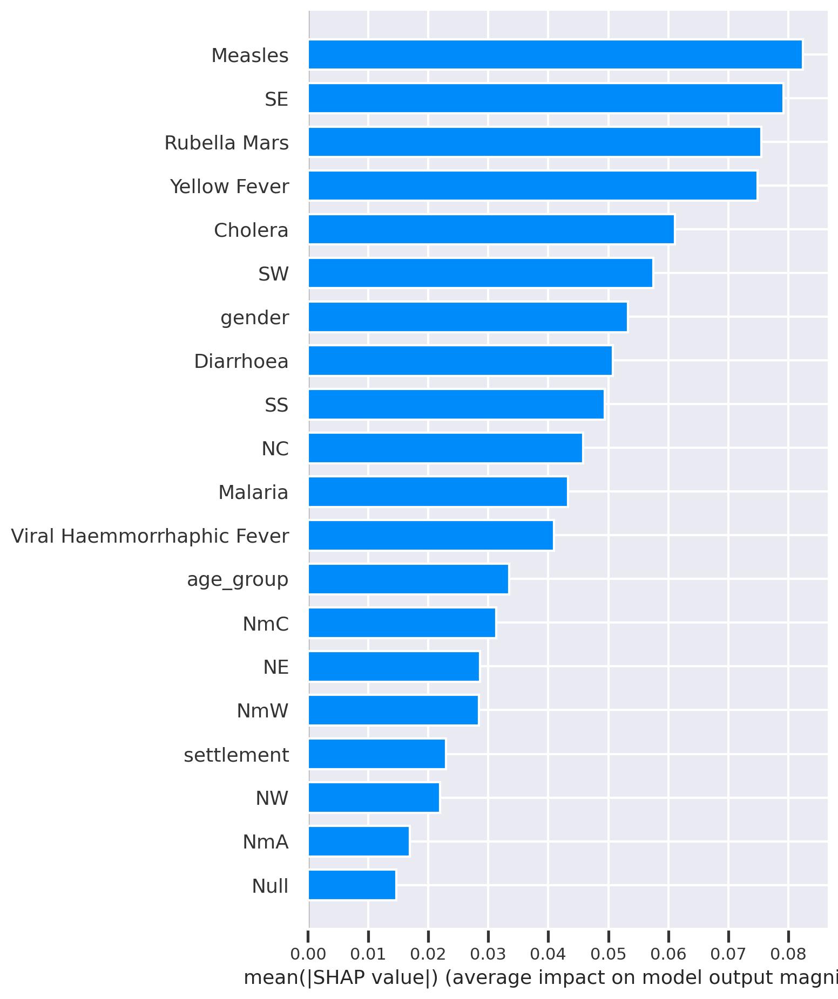

In [ ]:
gnb.fit(Xs_train, y_train)
columns = ['gender', 'settlement', 'status', 'ryear', 'rmonth', 'rday', 'age_group',
           'NC', 'NE', 'NW', 'SE', 'SS', 'SW', 'NmA', 'NmC', 'NmW', 'Null', 'Cholera', 'Diarrhoea',
           'Ebola', 'Malaria', 'Marburg Virus', 'Measles', 'Meningitis', 'Rubella Mars',
           'Viral Haemmorrhaphic Fever', 'Yellow Fever']

subset_size = 1000

# Creating the DataFrame for Naive Bayes
Xs_train_df_nb = pd.DataFrame(Xs_train, columns=columns)

Xs_subset = Xs_train_df_nb.sample(subset_size, random_state=42)

# Using SHAP on the subset
explainer_nb_subset = shap.KernelExplainer(model=gnb.predict, data=Xs_subset)
shap_values_nb_subset = explainer_nb_subset.shap_values(Xs_test)

# Getting the feature names from the DataFrame
feature_names = Xs_subset.columns

# Plotting a summary bar plot with the exact feature names for Naive Bayes
shap.summary_plot(shap_values_nb_subset, Xs_test, feature_names=feature_names, plot_type="bar")

In [ ]:
gnb = GaussianNB()

# Define the hyperparameters and their possible values
param_grid = {
    'var_smoothing': [1e-9, 1e-8, 1e-7, 1e-6, 1e-5]
}

# Create the GridSearchCV object
grid_search = GridSearchCV(estimator=gnb, param_grid=param_grid, cv=5, scoring='accuracy')

# Fit the model to the training data
grid_search.fit(X_train, y_train)

# Print the best hyperparameters and corresponding accuracy
print("Best Hyperparameters:", grid_search.best_params_)
print("Best Accuracy:", grid_search.best_score_)

Best Hyperparameters: {'var_smoothing': 1e-09}
Best Accuracy: 0.4938480853007836


In [ ]:
columns = ['gender', 'settlement', 'status', 'ryear', 'rmonth', 'rday', 'age_group',
           'NC', 'NE', 'NW', 'SE', 'SS', 'SW', 'NmA', 'NmC', 'NmW', 'Null', 'Cholera', 'Diarrhoea',
           'Ebola', 'Malaria', 'Marburg Virus', 'Measles', 'Meningitis', 'Rubella Mars',
           'Viral Haemmorrhaphic Fever', 'Yellow Fever']

# Creating the DataFrame for Naive Bayes
X_train_df_nb = pd.DataFrame(X_train, columns=columns)

# Using SHAP to explain the predictions made by the Naive Bayes model
explainer_nb = shap.KernelExplainer(model=gnb.predict, data=X_train_df_nb)
shap_values_nb = explainer_nb.shap_values(X_test)

# Getting the feature names from the DataFrame
feature_names = X_train_df_nb.columns

# Plotting a summary bar plot with the exact feature names for Naive Bayes
shap.summary_plot(shap_values_nb, X_test, feature_names=feature_names, plot_type="bar")

  0%|          | 0/5690 [00:00<?, ?it/s]

In [ ]:
from sklearn.naive_bayes import GaussianNB


gnb = GaussianNB()
gnb.fit(X_train, y_train)

GaussianNB()

In [ ]:
import lime
from lime.lime_tabular import LimeTabularExplainer

columns = ['gender', 'settlement', 'status', 'ryear', 'rmonth', 'rday', 'age_group',
           'NC', 'NE', 'NW', 'SE', 'SS', 'SW', 'NmA', 'NmC', 'NmW', 'Null', 'Cholera', 'Diarrhoea',
           'Ebola', 'Malaria', 'Marburg Virus', 'Measles', 'Meningitis', 'Rubella Mars',
           'Viral Haemmorrhaphic Fever', 'Yellow Fever']

# Converting X_train back to a Pandas DataFrame
X_train_df = pd.DataFrame(X_train, columns=X_train.columns)

# Using LIME to explain the prediction
explainer = LimeTabularExplainer(X_train_df.values, feature_names=X_train_df.columns, class_names=['0', '1'], discretize_continuous=True)

In [ ]:
instance_to_explain = X_test.iloc[0, :].values

explanation = explainer.explain_instance(
    instance_to_explain, gnb.predict_proba, num_features=len(X_train.columns)
)

In [ ]:
# Print the explanation
explanation.show_in_notebook(show_table=True, show_all=False)

# **Decision Tree Classifier Algorithm**

In [ ]:
!pip install scikit-learn graphviz

In [ ]:
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier, export_graphviz
import graphviz
from IPython.display import Image

dtc = DecisionTreeClassifier()
dtc.fit(X_train, y_train)

acc = dtc.score(X_test, y_test)*100
accuracies['Decision Tree'] = acc
print("Test Accuracy for Decision Tree: {:.2f}%".format(acc))

Test Accuracy for Decision Tree: 50.54%


In [ ]:
# Making predictions on the test data
predict = dtc.predict(X_test)

print(classification_report(y_test,predict))

              precision    recall  f1-score   support

           0       0.51      0.48      0.50      2860
           1       0.50      0.53      0.51      2830

    accuracy                           0.51      5690
   macro avg       0.51      0.51      0.51      5690
weighted avg       0.51      0.51      0.51      5690



In [ ]:
# Getting predicted probabilities for positive class
y_scores_dtc = dtc.predict_proba(X_test)[:, 1]

# Computing AUC for Decision Tree Classifier
roc_auc_dtc = roc_auc_score(y_test, y_scores_dtc)

# Print the AUC value for Decision Tree Classifier
print("AUC for Decision Tree Classifier:", roc_auc_dtc)

AUC for Decision Tree Classifier: 0.5052452494501964


AUC for Decision Tree Classifier: 0.5052452494501964


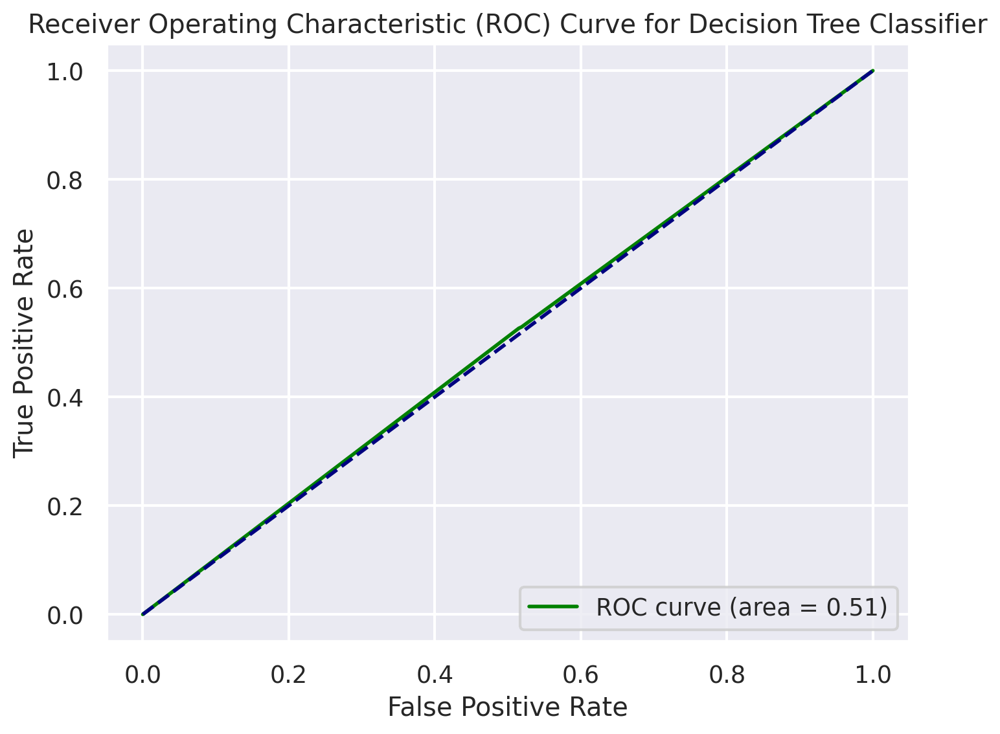

In [ ]:
from sklearn.metrics import roc_curve, auc, roc_auc_score
# Getting predicted probabilities for positive class
y_scores_dtc = dtc.predict_proba(X_test)[:, 1]

# Computing ROC curve and ROC area for each class
fpr_dtc, tpr_dtc, _ = roc_curve(y_test, y_scores_dtc)
roc_auc_dtc = auc(fpr_dtc, tpr_dtc)

# Plotting ROC curve for Decision Tree Classifier
plt.figure(figsize=(8, 6))
plt.plot(fpr_dtc, tpr_dtc, color='green', lw=2, label='ROC curve (area = {:.2f})'.format(roc_auc_dtc))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve for Decision Tree Classifier')
plt.legend(loc='lower right')

# Print the AUC value for Decision Tree Classifier
print("AUC for Decision Tree Classifier:", roc_auc_dtc)

plt.show()

<Axes: ylabel='Feature'>

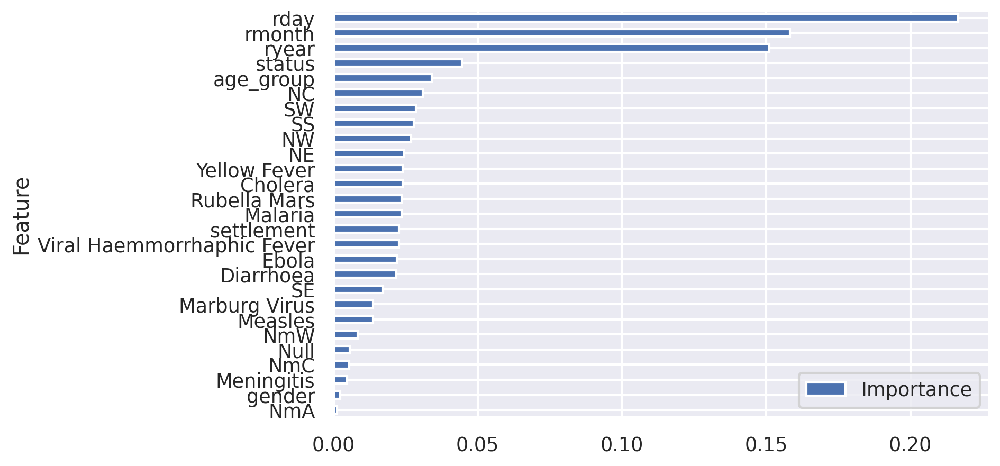

In [ ]:
importance = dtc.feature_importances_
# std = np.std([tree.feature_importances_ for tree in rf.estimators_]), axis=0)
feature_importance = pd.DataFrame({'Feature': X.columns, 'Importance': importance})
feature_importance = feature_importance.sort_values('Importance', ascending=True)
feature_importance.plot(x='Feature', y='Importance', kind='barh', figsize=(8, 5))

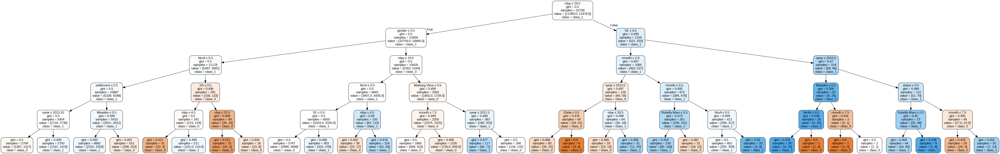

In [ ]:
# Create a Decision Tree Classifier with limited depth
dtc_small = DecisionTreeClassifier(max_depth=5)
dtc_small.fit(X_train, y_train)

# Visualize the decision tree using graphviz
dot_data_small = export_graphviz(dtc_small, out_file=None, filled=True, rounded=True, special_characters=True,
                                feature_names=X_train.columns, class_names=['class_0', 'class_1'])

graph_small = graphviz.Source(dot_data_small)

# Save the visualization to a file (e.g., 'decision_tree_small.png')
graph_small.render("decision_tree_small", format="png")

Image("decision_tree_small.png")

In [ ]:
# Defining the Decision Tree model
dtc = DecisionTreeClassifier()

# Defining hyperparameters and their possible values for tuning
param_grid = {
    'criterion': ['gini', 'entropy'],
    'splitter': ['best', 'random'],
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['auto', 'sqrt', 'log2', None]
}

# Performing grid search with cross-validation
grid_search = GridSearchCV(dtc, param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, y_train)

# Getting the best hyperparameters
best_params = grid_search.best_params_
print("Best Hyperparameters:", best_params)

# Evaluating the model with the best hyperparameters on the test set
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Test Accuracy:", accuracy)

Best Hyperparameters: {'criterion': 'gini', 'max_depth': 50, 'max_features': None, 'min_samples_leaf': 4, 'min_samples_split': 2, 'splitter': 'random'}
Test Accuracy: 0.5012302284710017


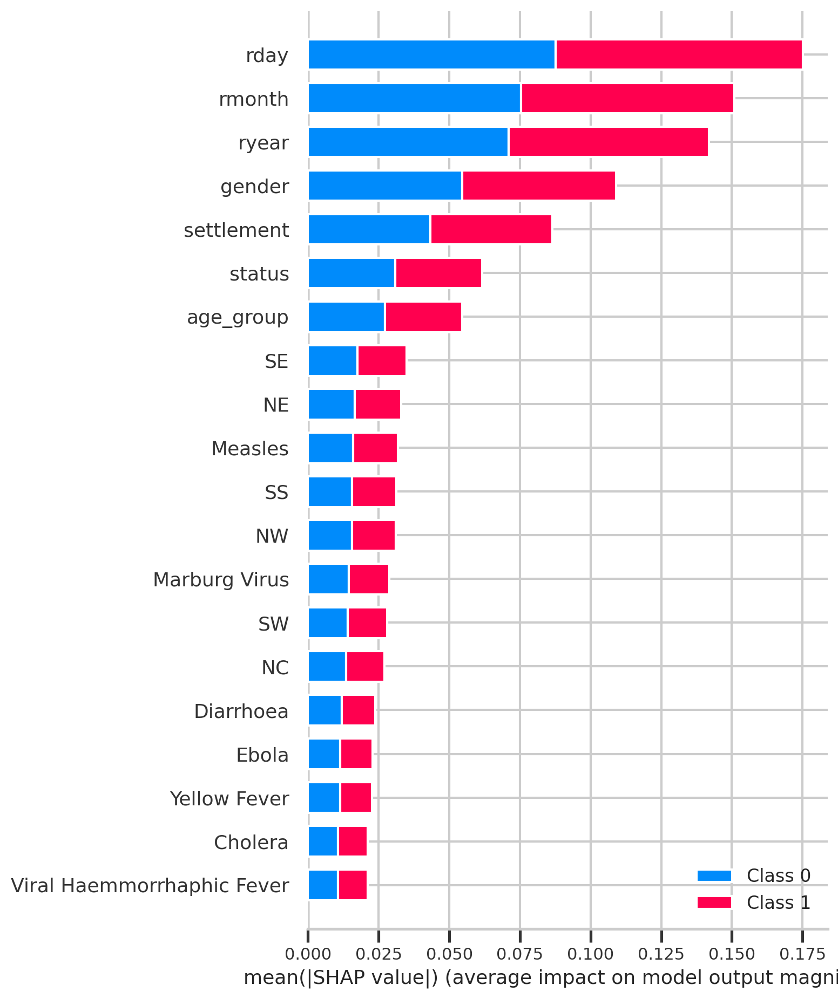

In [ ]:
columns = ['gender', 'settlement', 'status', 'ryear', 'rmonth', 'rday', 'age_group',
           'NC', 'NE', 'NW', 'SE', 'SS', 'SW', 'NmA', 'NmC', 'NmW', 'Null', 'Cholera', 'Diarrhoea',
           'Ebola', 'Malaria', 'Marburg Virus', 'Measles', 'Meningitis', 'Rubella Mars',
           'Viral Haemmorrhaphic Fever', 'Yellow Fever']

# Creating the DataFrame for Decision Tree Classifier (DTC)
X_train_df = pd.DataFrame(X_train, columns=columns)

# Using SHAP to explain the predictions made by the DTC model
explainer = shap.TreeExplainer(dtc)
shap_values = explainer.shap_values(X_train_df)

# Getting the feature names from the DataFrame
feature_names = X_train_df.columns

# Plotting a summary bar plot with the exact feature names for DTC
shap.summary_plot(shap_values, X_train_df, feature_names=feature_names, plot_type="bar")

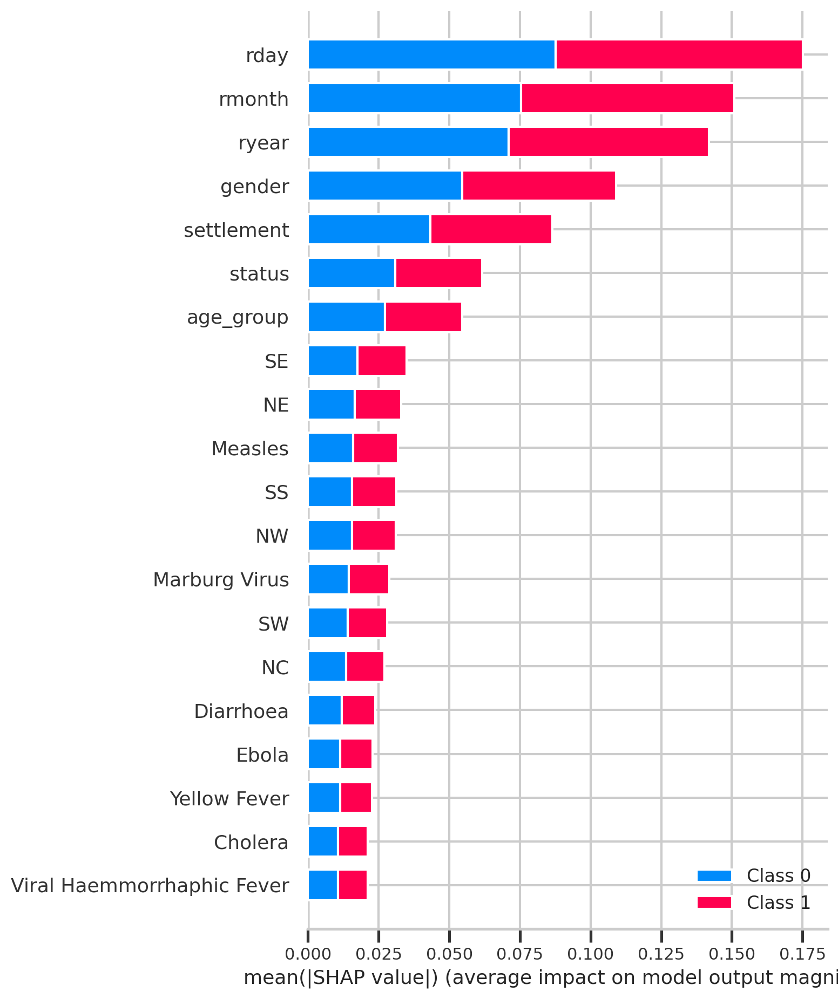

In [ ]:
shap.summary_plot(shap_values, X_test, feature_names=feature_names)

In [ ]:
from lime.lime_tabular import LimeTabularExplainer
import lime
from sklearn.tree import DecisionTreeClassifier

dtc = DecisionTreeClassifier()
dtc.fit(X_train, y_train)

columns = ['gender', 'settlement', 'status', 'ryear', 'rmonth', 'rday', 'age_group',
           'NC', 'NE', 'NW', 'SE', 'SS', 'SW', 'NmA', 'NmC', 'NmW', 'Null', 'Cholera', 'Diarrhoea',
           'Ebola', 'Malaria', 'Marburg Virus', 'Measles', 'Meningitis', 'Rubella Mars',
           'Viral Haemmorrhaphic Fever', 'Yellow Fever']

X_train_df = pd.DataFrame(X_train, columns=columns)

# Using LIME to explain a prediction for DTC
explainer = LimeTabularExplainer(X_train_df.values, feature_names=X_train_df.columns, class_names=['0', '1'], discretize_continuous=True)

In [ ]:
instance_to_explain = X_test.iloc[0, :].values

explanation = explainer.explain_instance(
    instance_to_explain, dtc.predict_proba, num_features=len(X_train.columns)
)

In [ ]:
# Print the explanation for DTC
explanation.show_in_notebook(show_table=True, show_all=False)

# **Random Forest Classification**

In [ ]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier(n_estimators=1000, random_state=1)
rf.fit(X_train, y_train)

acc = rf.score(X_test, y_test)*100
accuracies['Random Forest'] = acc
print("Test Accuracy for Random Forest: {:.2f}%".format(acc))

Test Accuracy for Random Forest: 50.39%


In [ ]:
# Making predictions on the test data
predict = rf.predict(X_test)

print(classification_report(y_test,predict))

              precision    recall  f1-score   support

           0       0.51      0.49      0.50      2860
           1       0.50      0.52      0.51      2830

    accuracy                           0.50      5690
   macro avg       0.50      0.50      0.50      5690
weighted avg       0.50      0.50      0.50      5690



<Axes: ylabel='Feature'>

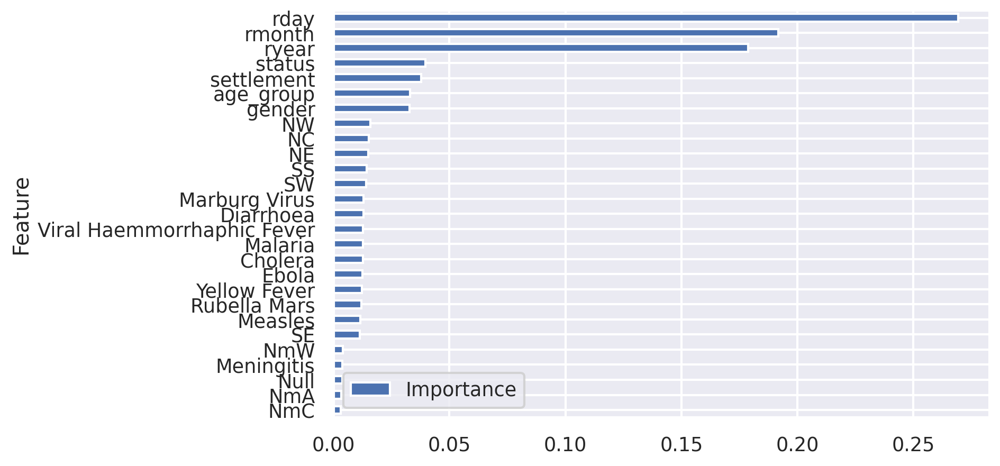

In [ ]:
importance = rf.feature_importances_
# std = np.std([tree.feature_importances_ for tree in rf.estimators_]), axis=0)
feature_importance = pd.DataFrame({'Feature': X.columns, 'Importance': importance})
feature_importance = feature_importance.sort_values('Importance', ascending=True)
feature_importance.plot(x='Feature', y='Importance', kind='barh', figsize=(8, 5))

AUC for Random Forest: 0.49971749981467295


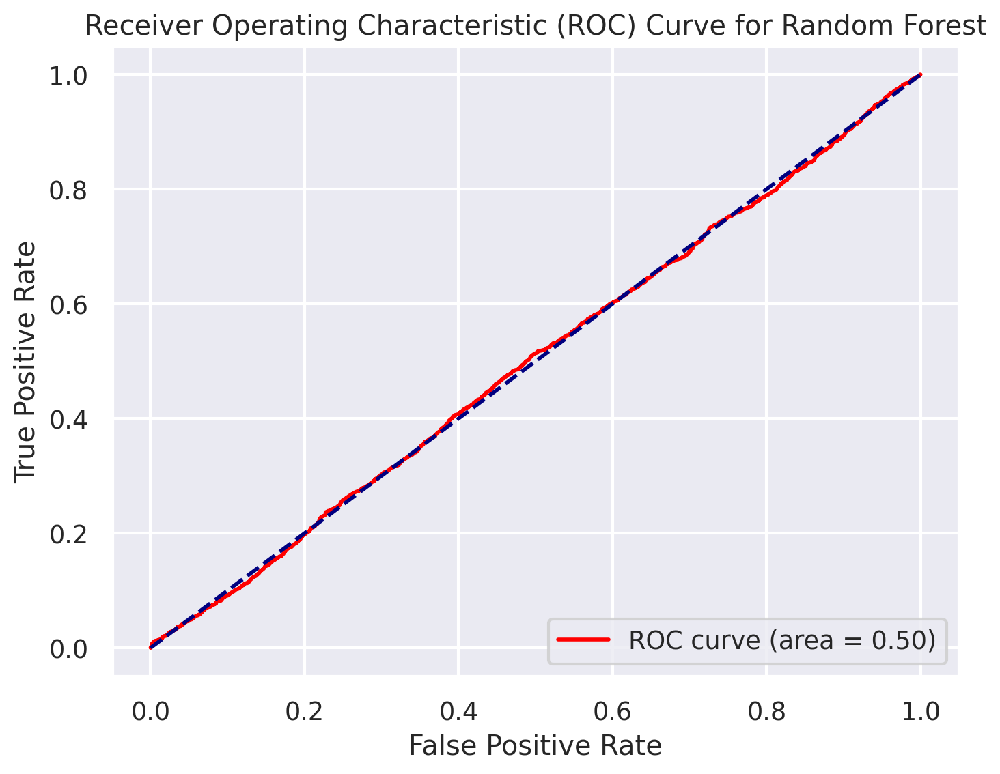

AUC (roc_auc_score) for Random Forest: 0.49971749981467295


In [ ]:
from sklearn.metrics import roc_curve, auc, roc_auc_score
import matplotlib.pyplot as plt

# Get predicted probabilities for positive class
y_scores_rf = rf.predict_proba(X_test)[:, 1]

# Compute ROC curve and ROC area for each class
fpr_rf, tpr_rf, _ = roc_curve(y_test, y_scores_rf)
roc_auc_rf = auc(fpr_rf, tpr_rf)

# Print the AUC value for Random Forest
print("AUC for Random Forest:", roc_auc_rf)

# Plot ROC curve for Random Forest
plt.figure(figsize=(8, 6))
plt.plot(fpr_rf, tpr_rf, color='red', lw=2, label='ROC curve (area = {:.2f})'.format(roc_auc_rf))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve for Random Forest')
plt.legend(loc='lower right')
plt.show()

# Print the AUC value for Random Forest using roc_auc_score
roc_auc_score_value_rf = roc_auc_score(y_test, y_scores_rf)
print("AUC (roc_auc_score) for Random Forest:", roc_auc_score_value_rf)

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier

# Defining the parameter grid
param_grid = {
    'n_estimators': [50, 100, 200, 500],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

rf = RandomForestClassifier(n_estimators=1000, random_state=1)
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, scoring='accuracy')

# Fit the model to the data
grid_search.fit(X_train, y_train)

# Get the best parameters
best_params = grid_search.best_params_
print("Best Hyperparameters:", best_params)

best_rf = grid_search.best_estimator_

# Make predictions on the test data using the best model
y_pred_rf = best_rf.predict(X_test)

accuracy = accuracy_score(y_test, y_pred_rf)
print("Test Accuracy for Best Random Forest Model: {:.2f}%".format(accuracy))

Best Hyperparameters: {'max_depth': 20, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 50}
Test Accuracy for Best Random Forest Model: 0.50%


# **Comparing Models**

In [ ]:
lr = LogisticRegression()
lr.fit(Xs_train, y_train)

acc = lr.score(Xs_test, y_test)*100
accuracies['Logistic Regression'] = acc
print("Test Accuracy  of Logistic Regression Algorithm: {:.2f}%".format(acc))

Test Accuracy  of Logistic Regression Algorithm: 51.05%


In [ ]:
from sklearn.neighbors import KNeighborsClassifier
knn_model = KNeighborsClassifier(n_neighbors=2)
knn_model.fit(X_train, y_train)

# Make predictions
y_pred_knn = knn_model.predict(X_test)

# Evaluate accuracy
accuracy = accuracy_score(y_test, y_pred_knn)
print(f"Accuracy: {accuracy}")

Accuracy: 0.501054481546573


In [ ]:
from sklearn.svm import SVC

svm = SVC(kernel='linear')
svm.fit(X_train, y_train)

acc = svm.score(X_test, y_test)*100
accuracies['SVM'] = acc
print("Test Accuracy  of SVM Algorithm: {:.2f}%".format(acc))

Test Accuracy  of SVM Algorithm: 51.25%


In [ ]:
from sklearn.naive_bayes import GaussianNB

gnb = GaussianNB()
gnb.fit(X_train, y_train)

acc = gnb.score(X_test, y_test)*100
accuracies['Naive Bayes'] = acc
print("Test Accuracy for Naive Bayes: {:.2f}%".format(acc))

Test Accuracy for Naive Bayes: 51.09%


In [ ]:
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier, export_graphviz

dtc = DecisionTreeClassifier()
dtc.fit(X_train, y_train)

acc = dtc.score(X_test, y_test)*100
accuracies['Decision Tree'] = acc
print("Test Accuracy for Decision Tree: {:.2f}%".format(acc))

Test Accuracy for Decision Tree: 50.12%


In [ ]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier(n_estimators=1000, random_state=1)
rf.fit(X_train, y_train)

acc = rf.score(X_test, y_test)*100
accuracies['Random Forest'] = acc
print("Test Accuracy for Random Forest: {:.2f}%".format(acc))

Test Accuracy for Random Forest: 50.39%


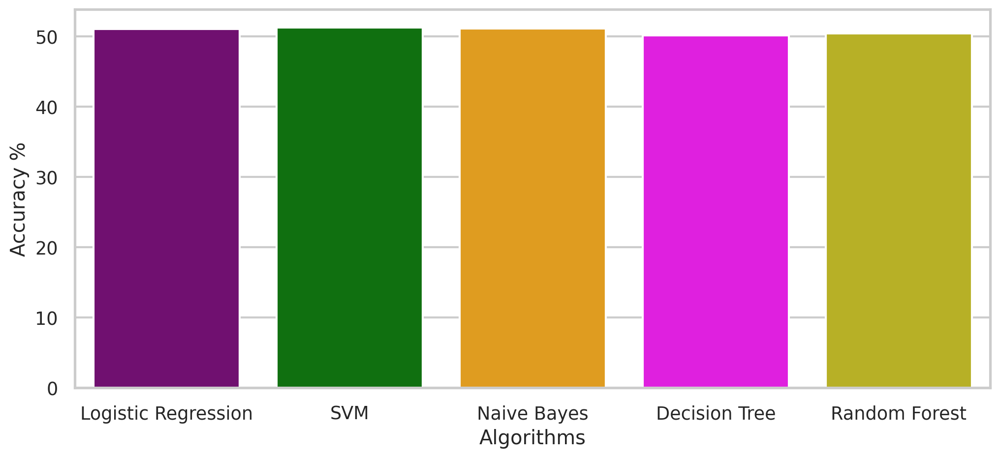

In [ ]:
colors = ["purple", "green", "orange", "magenta", "#CFC60E", "#0FBBAE"]

sns.set_style("whitegrid")
plt.figure(figsize=(12,5))
plt.yticks(np.arange(0, 100, 10))
plt.ylabel("Accuracy %")
plt.xlabel("Algorithms")
sns.barplot(x=list(accuracies.keys()), y=list(accuracies.values()), palette=colors)
plt.show()

In [ ]:
# Print keys in the accuracies dictionary
print("Model keys:", list(accuracies.keys()))

# Print colors in the colors list
print("Colors:", colors)

Model keys: ['Logistic Regression', 'SVM', 'Naive Bayes', 'Decision Tree', 'Random Forest']
Colors: ['purple', 'green', 'orange', 'magenta', '#CFC60E', '#0FBBAE']


# **Confusion Matrix**

In [ ]:
y_pred_lr = lr.predict(X_test)
y_pred_knn = knn_model.predict(X_test)
y_pred_svm = svm.predict(X_test)
y_pred_nb = gnb.predict(X_test)
y_pred_dtc = dtc.predict(X_test)
y_pred_rf = rf.predict(X_test)

In [ ]:
from sklearn.metrics import confusion_matrix

cm_lr = confusion_matrix(y_test, y_pred_lr)
cm_knn = confusion_matrix(y_test, y_pred_knn)
cm_svm = confusion_matrix(y_test, y_pred_svm)
cm_nb = confusion_matrix(y_test, y_pred_nb)
cm_dtc = confusion_matrix(y_test, y_pred_dtc)
cm_rf = confusion_matrix(y_test, y_pred_rf)

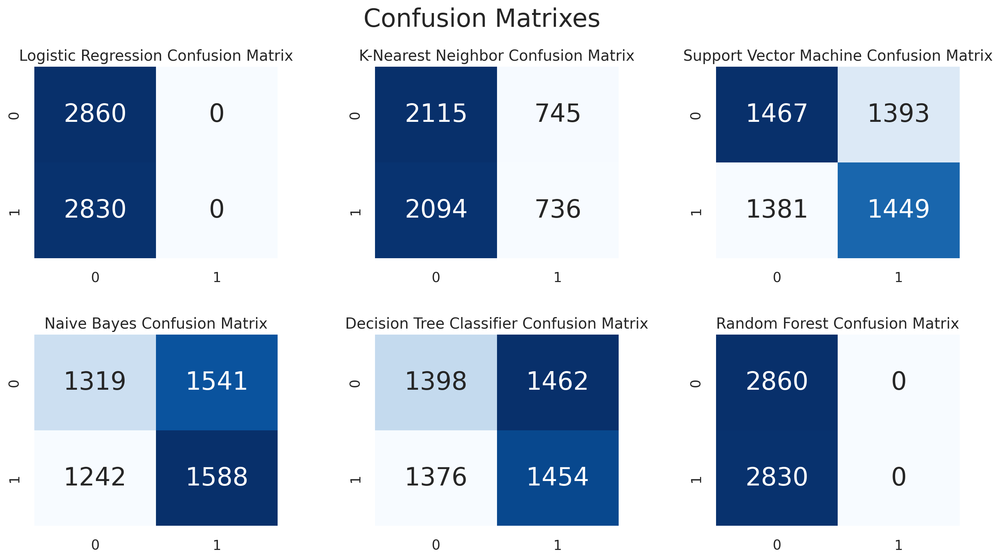

In [ ]:
plt.figure(figsize=(16, 8))

plt.suptitle("Confusion Matrixes", fontsize=24)
plt.subplots_adjust(wspace=0.4, hspace=0.4)

plt.subplot(2,3,1)
plt.title("Logistic Regression Confusion Matrix")
sns.heatmap(cm_lr, annot=True, cmap="Blues", fmt="d", cbar=False, annot_kws={"size":24})

plt.subplot(2,3,2)
plt.title("K-Nearest Neighbor Confusion Matrix")
sns.heatmap(cm_knn, annot=True, cmap="Blues", fmt="d", cbar=False, annot_kws={"size":24})

plt.subplot(2,3,3)
plt.title("Support Vector Machine Confusion Matrix")
sns.heatmap(cm_svm, annot=True, cmap="Blues", fmt="d", cbar=False, annot_kws={"size":24})

plt.subplot(2,3,4)
plt.title("Naive Bayes Confusion Matrix")
sns.heatmap(cm_nb, annot=True, cmap="Blues", fmt="d", cbar=False, annot_kws={"size":24})

plt.subplot(2,3,5)
plt.title("Decision Tree Classifier Confusion Matrix")
sns.heatmap(cm_dtc, annot=True, cmap="Blues", fmt="d", cbar=False, annot_kws={"size":24})

plt.subplot(2,3,6)
plt.title("Random Forest Confusion Matrix")
sns.heatmap(cm_lr, annot=True, cmap="Blues", fmt="d", cbar=False, annot_kws={"size":24})

plt.show()